In [ ]:
from kaggle.api.kaggle_api_extended import KaggleApi
import os

# 1. Set the download folder
download_path = "../data"

# 2. Create the folder if it doesn't exist
if not os.path.exists(download_path):
    os.makedirs(download_path)
    print(f"Created folder: {download_path}")
else:
    print(f"Folder already exists: {download_path}")

# 3. Initialize and authenticate Kaggle API
api = KaggleApi()
api.authenticate()

# 4. Dataset name on Kaggle
dataset_name = "bhavikjikadara/dog-and-cat-classification-dataset"

# 5. Download and unzip the dataset
api.dataset_download_files(
    dataset_name,
    path=download_path,
    unzip=True
)
print("Download completed. Dataset is in:", os.path.abspath(download_path))

In [1]:
import os
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import random
from tensorflow.keras.preprocessing.image import ImageDataGenerator
import tensorflow as tf
from tensorflow.keras import layers, models
from tensorflow.keras.preprocessing import image
from tensorflow.keras.models import load_model
from tensorflow.keras.applications import MobileNetV2
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint, ReduceLROnPlateau

In [ ]:
DATA_DIR = "../data"

for split in ["train", "val", "test"]:
    print(f"\n📁 {split.upper()} DATASET")
    split_path = os.path.join(DATA_DIR, split)
    for cls in os.listdir(split_path):
        cls_path = os.path.join(split_path, cls)
        count = len(os.listdir(cls_path))
        print(f"  {cls}: {count} images")



📁 TRAIN DATASET
  0: 10000 images
  1: 9999 images

📁 VAL DATASET
  0: 1250 images
  1: 1250 images

📁 TEST DATASET
  0: 1250 images
  1: 1250 images


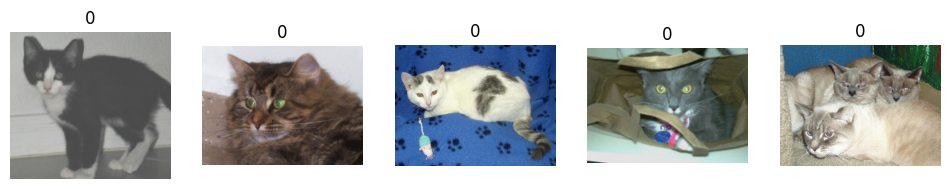

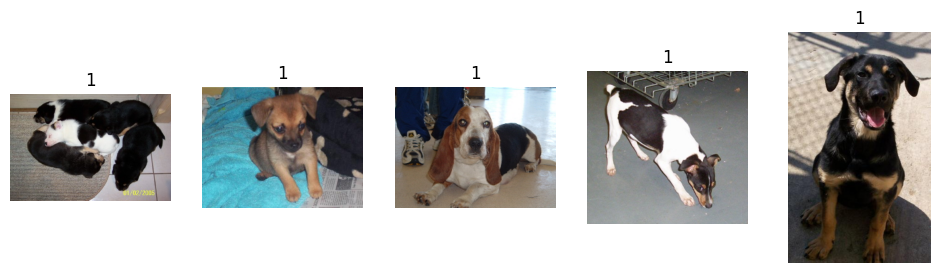

In [8]:
def show_samples(split="train", cls="cat", num=5):
    path = os.path.join(DATA_DIR, split, cls)
    imgs = random.sample(os.listdir(path), num)
    
    plt.figure(figsize=(12,3))
    for i, img in enumerate(imgs):
        img_path = os.path.join(path, img)
        image = mpimg.imread(img_path)
        plt.subplot(1, num, i+1)
        plt.imshow(image)
        plt.axis('off')
        plt.title(cls)
    plt.show()

# Example usage:
show_samples("train", "0")
show_samples("train", "1")

In [9]:
os.makedirs('data/resized_imgs', exist_ok=True)

In [6]:
original_dirs = ['data/train', 'data/val', 'data/test']
# Folder to save resized images
resized_base_dir = 'data/resized_imgs'
target_size = (224, 224)

In [11]:
for original_dir in original_dirs:
    split_name = os.path.basename(original_dir)  # train / val / test
    resized_dir = os.path.join(resized_base_dir, split_name)

    # Loop over classes (cat/dog)
    for cls in os.listdir(original_dir):
        class_path = os.path.join(original_dir, cls)
        save_class_path = os.path.join(resized_dir, cls)
        os.makedirs(save_class_path, exist_ok=True)

        # Loop over images
        for img_name in os.listdir(class_path):
            img_path = os.path.join(class_path, img_name)
            try:
                img = Image.open(img_path)
                # Convert to RGB if not already
                if img.mode != 'RGB':
                    img = img.convert('RGB')
                img = img.resize(target_size)
                save_path = os.path.join(save_class_path, img_name)
                img.save(save_path)
            except Exception as e:
                print(f"Error processing {img_path}: {e}")

print("✅ All train, val, test images resized and saved successfully.")


KeyboardInterrupt: 

In [8]:
image_dir = "../data/resized_imgs"

for split in ["train", "val", "test"]:
    print(f"\n📁 {split.upper()} DATASET")
    split_path = os.path.join(image_dir, split)
    for cls in os.listdir(split_path):
        cls_path = os.path.join(split_path, cls)
        count = len(os.listdir(cls_path))
        print(f"  {cls}: {count} images")



📁 TRAIN DATASET
  0: 10000 images
  1: 9999 images

📁 VAL DATASET
  0: 1250 images
  1: 1250 images

📁 TEST DATASET
  0: 1250 images
  1: 1250 images


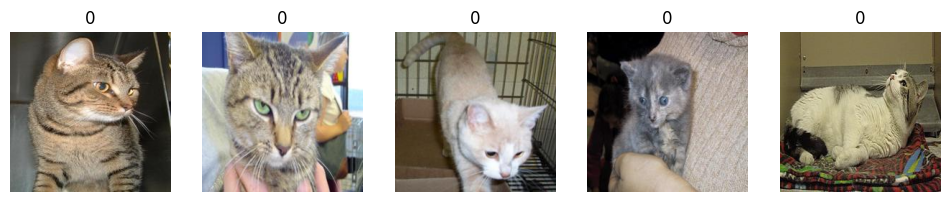

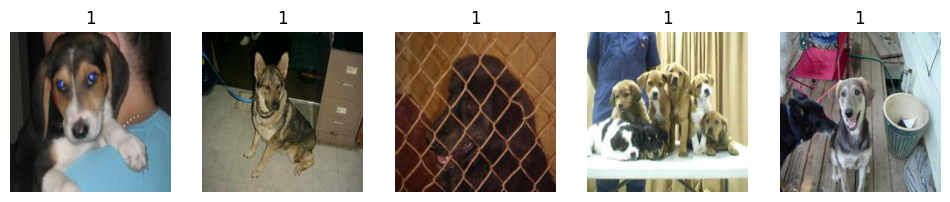

In [13]:
DATA_DIR = "data/resized_imgs"

def show_samples(split="train", cls="cat", num=5):
    path = os.path.join(DATA_DIR, split, cls)
    imgs = random.sample(os.listdir(path), num)
    
    plt.figure(figsize=(12,3))
    for i, img in enumerate(imgs):
        img_path = os.path.join(path, img)
        image = mpimg.imread(img_path)
        plt.subplot(1, num, i+1)
        plt.imshow(image)
        plt.axis('off')
        plt.title(cls)
    plt.show()

# Example usage:
show_samples("train", "0")
show_samples("train", "1")

In [10]:
# ✅ Step 6: Data Preprocessing
BATCH_SIZE = 32
train_datagen = ImageDataGenerator(
    rescale=1./255,
    rotation_range=20,
    width_shift_range=0.2,
    height_shift_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True
)
val_datagen = ImageDataGenerator(rescale=1./255)
test_datagen = ImageDataGenerator(rescale=1./255)

train_data = train_datagen.flow_from_directory(
    '../data/resized_imgs/train',
    target_size=target_size,
    batch_size=BATCH_SIZE,
    class_mode='binary'
)
val_data = val_datagen.flow_from_directory(
    '../data/resized_imgs/val',
    target_size=target_size,
    batch_size=BATCH_SIZE,
    class_mode='binary'
)
test_data = test_datagen.flow_from_directory(
    '../data/resized_imgs/test',
    target_size=target_size,
    batch_size=BATCH_SIZE,
    class_mode='binary'
)


Found 19999 images belonging to 2 classes.
Found 2500 images belonging to 2 classes.
Found 2500 images belonging to 2 classes.


In [ ]:
# ✅ Step 7: CNN Model
model = models.Sequential([
    layers.Input(shape=(224, 224, 3)),
    layers.Conv2D(32, (3,3), activation='relu'),
    layers.MaxPooling2D(2,2),
    layers.Conv2D(64, (3,3), activation='relu'),
    layers.MaxPooling2D(2,2),
    layers.Dropout(0.2),
    layers.Conv2D(64, (3,3), activation='relu'),
    layers.Dropout(0.2),
    layers.MaxPooling2D(2,2),
    layers.Conv2D(128, (3,3), activation='relu'),
    layers.MaxPooling2D(2,2),
    layers.GlobalAveragePooling2D(),
    layers.Dense(128, activation='relu'),
    layers.Dropout(0.3),
    layers.Dense(1, activation='sigmoid')
])

In [ ]:
model.compile(optimizer='adam',
              loss='binary_crossentropy',
              metrics=['accuracy'])

model.summary()

Model: "sequential_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_4 (Conv2D)               │ (None, 224, 224, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization             │ (None, 224, 224, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation (Activation)         │ (None, 224, 224, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_4 (MaxPooling2D)  │ (None, 112, 112, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_5 (Conv2D)               │ (None, 112, 112, 64)   │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_1           │ (None, 112, 112, 64)   │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_1 (Activation)       │ (None, 112, 112, 64)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_5 (MaxPooling2D)  │ (None, 56, 56, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_3 (Dropout)             │ (None, 56, 56, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_6 (Conv2D)               │ (None, 56, 56, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_2           │ (None, 56, 56, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_2 (Activation)       │ (None, 56, 56, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_6 (MaxPooling2D)  │ (None, 28, 28, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_4 (Dropout)             │ (None, 28, 28, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_7 (Conv2D)               │ (None, 28, 28, 256)    │       295,168 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_3           │ (None, 28, 28, 256)    │         1,024 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_3 (Activation)       │ (None, 28, 28, 256)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_7 (MaxPooling2D)  │ (None, 14, 14, 256)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_average_pooling2d_1      │ (None, 256)            │             0 │
│ (GlobalAveragePooling2D)        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_2 (Dense)                 │ (None, 128)            │        32,896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_5 (Dropout)             │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_3 (Dense)                 │ (None, 1)              │           129 │
└─────────────────────────────────┴────────────────────────┴─────────────

 Total params: 423,361 (1.61 MB)

 Trainable params: 422,401 (1.61 MB)

 Non-trainable params: 960 (3.75 KB)

In [ ]:
# ✅ Step 8: Train the Model
EPOCHS = 20
history = model.fit(
    train_data,
    validation_data=val_data,
    epochs=EPOCHS
)

Epoch 1/20
625/625 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - accuracy: 0.5904 - loss: 0.7949

625/625 ━━━━━━━━━━━━━━━━━━━━ 1505s 2s/step - accuracy: 0.6054 - loss: 0.7458 - val_accuracy: 0.5920 - val_loss: 0.7333 - learning_rate: 0.0010
Epoch 2/20
625/625 ━━━━━━━━━━━━━━━━━━━━ 1340s 2s/step - accuracy: 0.6568 - loss: 0.6571 - val_accuracy: 0.5120 - val_loss: 1.0622 - learning_rate: 0.0010
Epoch 3/20
625/625 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - accuracy: 0.6859 - loss: 0.6138

625/625 ━━━━━━━━━━━━━━━━━━━━ 1478s 2s/step - accuracy: 0.6858 - loss: 0.6079 - val_accuracy: 0.6240 - val_loss: 0.6676 - learning_rate: 0.0010
Epoch 4/20
625/625 ━━━━━━━━━━━━━━━━━━━━ 0s 8s/step - accuracy: 0.7063 - loss: 0.5835

625/625 ━━━━━━━━━━━━━━━━━━━━ 5196s 8s/step - accuracy: 0.7054 - loss: 0.5817 - val_accuracy: 0.6820 - val_loss: 0.5915 - learning_rate: 0.0010
Epoch 5/20
625/625 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - accuracy: 0.7177 - loss: 0.5665

625/625 ━━━━━━━━━━━━━━━━━━━━ 1278s 2s/step - accuracy: 0.7235 - loss: 0.5572 - val_accuracy: 0.7600 - val_loss: 0.5038 - learning_rate: 0.0010
Epoch 6/20
625/625 ━━━━━━━━━━━━━━━━━━━━ 1434s 2s/step - accuracy: 0.7386 - loss: 0.5398 - val_accuracy: 0.6996 - val_loss: 0.6208 - learning_rate: 0.0010
Epoch 7/20
625/625 ━━━━━━━━━━━━━━━━━━━━ 1357s 2s/step - accuracy: 0.7532 - loss: 0.5208 - val_accuracy: 0.7576 - val_loss: 0.5111 - learning_rate: 0.0010
Epoch 8/20
625/625 ━━━━━━━━━━━━━━━━━━━━ 1251s 2s/step - accuracy: 0.7774 - loss: 0.4819 - val_accuracy: 0.7408 - val_loss: 0.5614 - learning_rate: 5.0000e-04


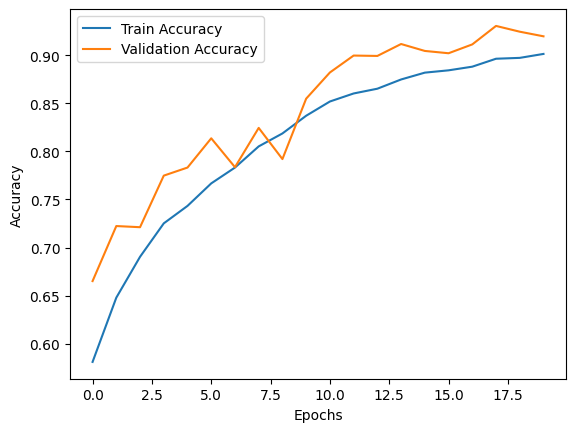

In [24]:
plt.plot(history.history['accuracy'], label='Train Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

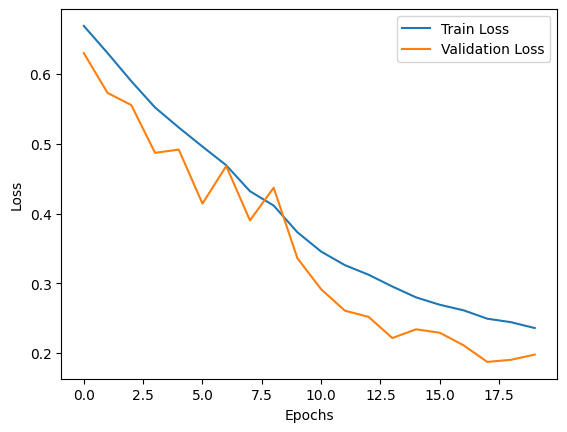

In [25]:
plt.plot(history.history['loss'], label='Train Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.show()


In [26]:
# Step 6: Evaluate on Test Set
test_loss, test_acc = model.evaluate(test_data)
print(f"\n✅ Test Accuracy: {test_acc:.4f}")

79/79 ━━━━━━━━━━━━━━━━━━━━ 55s 692ms/step - accuracy: 0.9192 - loss: 0.2033

✅ Test Accuracy: 0.9192


In [ ]:
# Step 6: Save the model
model.save("model1.h5")  # saves the entire model (architecture + weights + optimizer)
print("✅ Model saved successfully as model.h5")

✅ Model saved successfully as model.h5


In [28]:
model.save("model.keras")

In [38]:
model = load_model("model.keras")
print("✅ Model loaded successfully")

✅ Model loaded successfully


In [3]:
model = load_model("../model/model.h5")
print("✅ Model loaded successfully")

✅ Model loaded successfully


In [11]:
# Step 6: Evaluate on Test Set
test_loss, test_acc = model.evaluate(test_data)
print(f"\n✅ Test Accuracy: {test_acc:.4f}")

79/79 ━━━━━━━━━━━━━━━━━━━━ 58s 730ms/step - accuracy: 0.9192 - loss: 0.2033

✅ Test Accuracy: 0.9192


In [21]:
# Path to your test image
img_path = "./sto.png"  

In [22]:
# 1️⃣ Load image & resize
img = image.load_img(img_path, target_size=(224, 224))


In [23]:
# 2️⃣ Convert to array and normalize
img_array = image.img_to_array(img)
img_array = img_array / 255.0  # same as rescale=1./255
img_array = np.expand_dims(img_array, axis=0)  # add batch dimension (1, 224, 224, 3)

In [24]:
# 2️⃣ Predict
prediction = model.predict(img_array)
prob = prediction[0][0]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


In [25]:
# 3️⃣ Define thresholds
cat_threshold = 0.4
dog_threshold = 0.6

In [26]:
# 4️⃣ Classify
if prob < cat_threshold:
    label = "Cat 🐱"
elif prob > dog_threshold:
    label = "Dog 🐶"
else:
    label = "❌ Not a Cat or Dog"

c:\Users\HP\AppData\Local\Programs\Python\Python313\Lib\site-packages\IPython\core\pylabtools.py:170: UserWarning: Glyph 10060 (\N{CROSS MARK}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


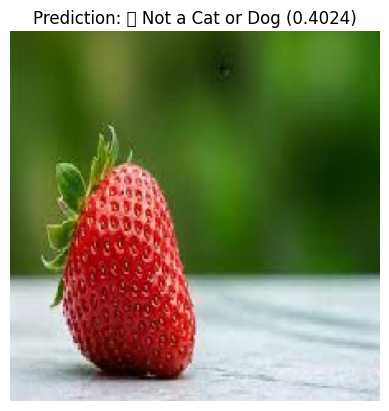

Predicted: ❌ Not a Cat or Dog, Confidence: 0.4024


In [27]:
# 5️⃣ Display
plt.imshow(img)
plt.axis('off')
plt.title(f"Prediction: {label} ({prob:.4f})")
plt.show()

print(f"Predicted: {label}, Confidence: {prob:.4f}")


🔍 Running predictions on TEST folder…
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


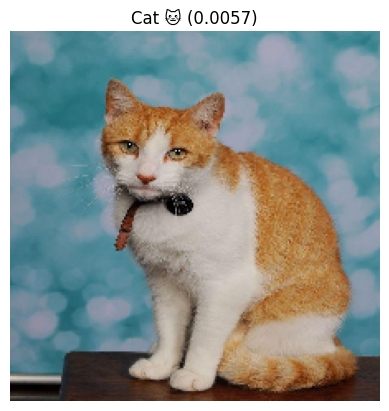

Image: cat_1.jpg
Prediction: Cat 🐱, Confidence: 0.0057

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step


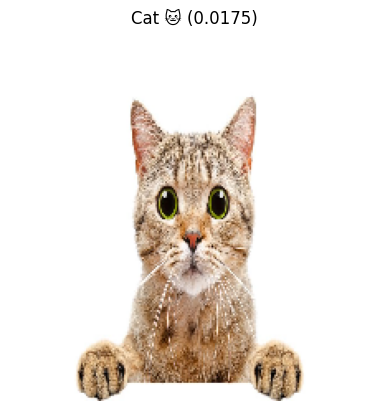

Image: cat_106.jpg
Prediction: Cat 🐱, Confidence: 0.0175

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step


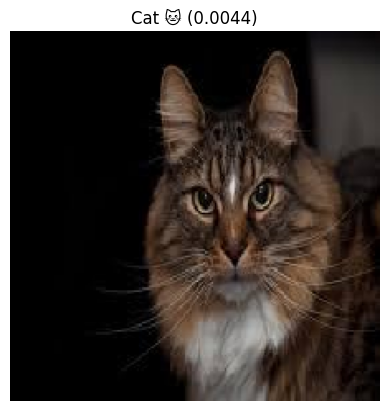

Image: cat_109.jpg
Prediction: Cat 🐱, Confidence: 0.0044

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


c:\Users\HP\AppData\Local\Programs\Python\Python313\Lib\site-packages\IPython\core\pylabtools.py:170: UserWarning: Glyph 128054 (\N{DOG FACE}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


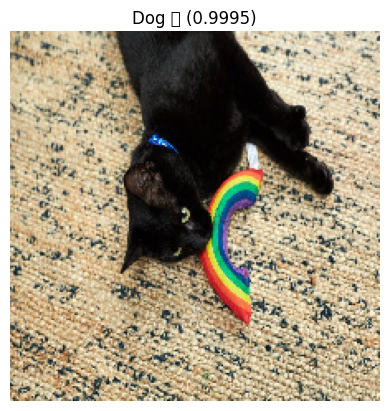

Image: cat_113.jpg
Prediction: Dog 🐶, Confidence: 0.9995

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


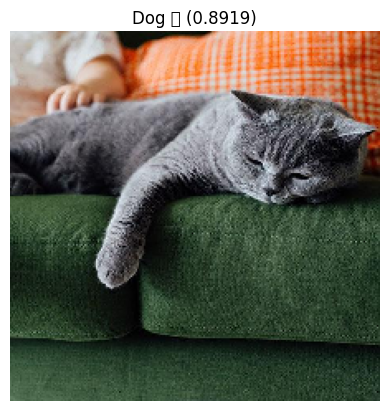

Image: cat_114.jpg
Prediction: Dog 🐶, Confidence: 0.8919

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


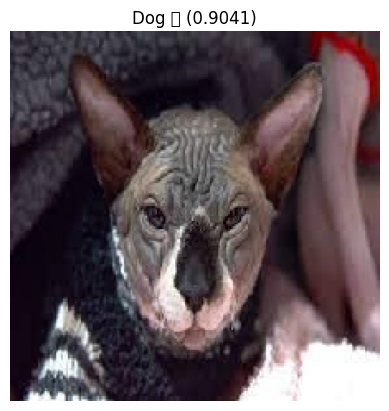

Image: cat_116.jpg
Prediction: Dog 🐶, Confidence: 0.9041

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step


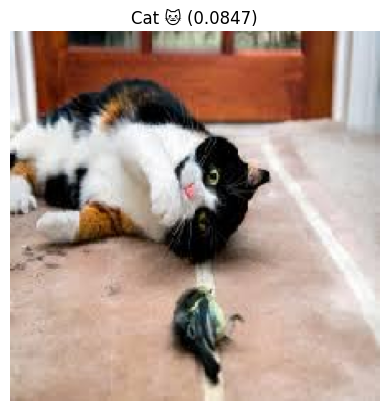

Image: cat_118.jpg
Prediction: Cat 🐱, Confidence: 0.0847

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


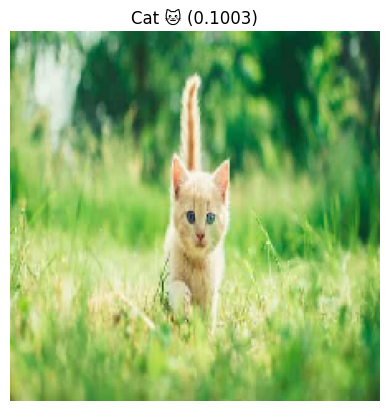

Image: cat_119.jpg
Prediction: Cat 🐱, Confidence: 0.1003

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


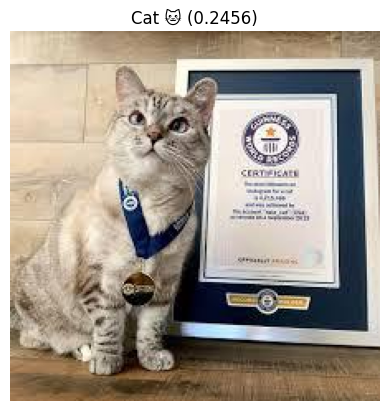

Image: cat_124.jpg
Prediction: Cat 🐱, Confidence: 0.2456

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step


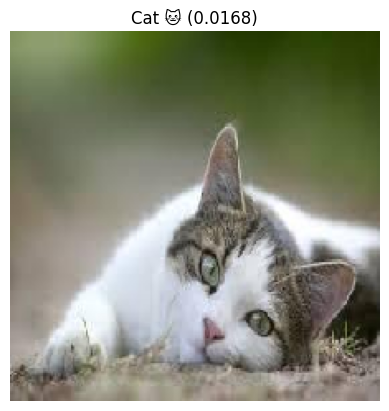

Image: cat_140.jpg
Prediction: Cat 🐱, Confidence: 0.0168

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step


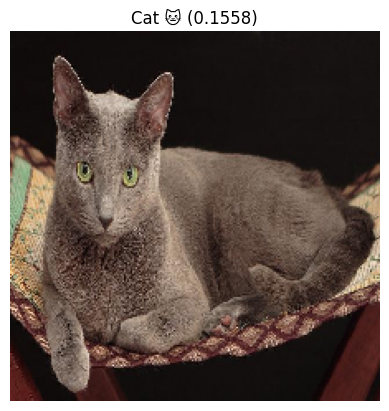

Image: cat_147.jpg
Prediction: Cat 🐱, Confidence: 0.1558

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step


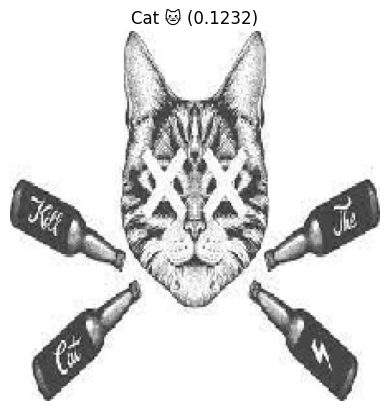

Image: cat_156.jpg
Prediction: Cat 🐱, Confidence: 0.1232

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


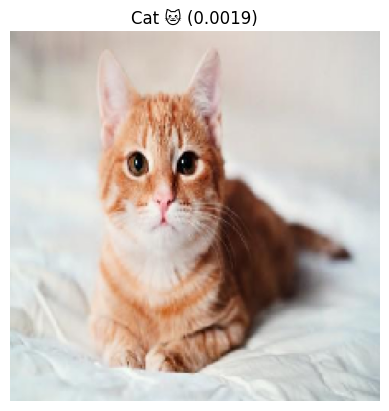

Image: cat_158.jpg
Prediction: Cat 🐱, Confidence: 0.0019

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


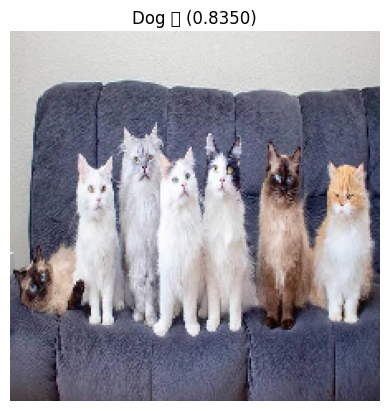

Image: cat_162.jpg
Prediction: Dog 🐶, Confidence: 0.8350

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step


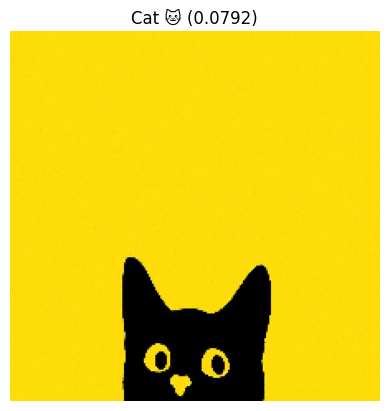

Image: cat_18.jpg
Prediction: Cat 🐱, Confidence: 0.0792

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step


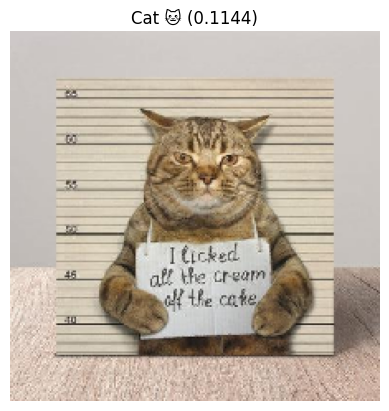

Image: cat_190.jpg
Prediction: Cat 🐱, Confidence: 0.1144

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


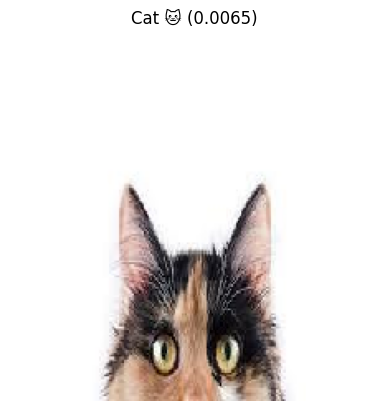

Image: cat_203.jpg
Prediction: Cat 🐱, Confidence: 0.0065

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step


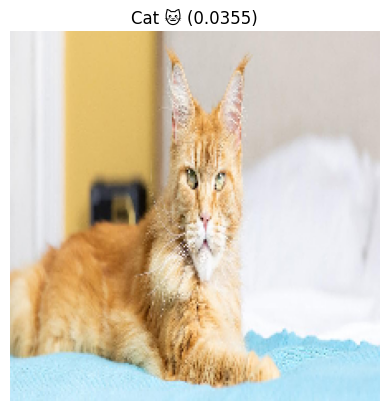

Image: cat_223.jpg
Prediction: Cat 🐱, Confidence: 0.0355

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


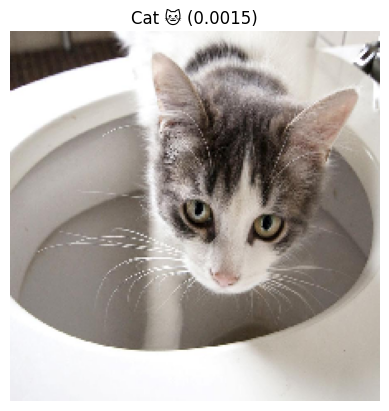

Image: cat_234.jpg
Prediction: Cat 🐱, Confidence: 0.0015

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step


c:\Users\HP\AppData\Local\Programs\Python\Python313\Lib\site-packages\IPython\core\pylabtools.py:170: UserWarning: Glyph 10060 (\N{CROSS MARK}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


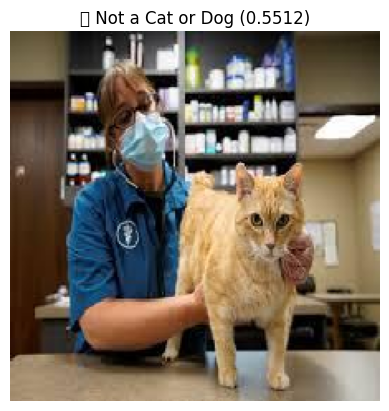

Image: cat_244.jpg
Prediction: ❌ Not a Cat or Dog, Confidence: 0.5512

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


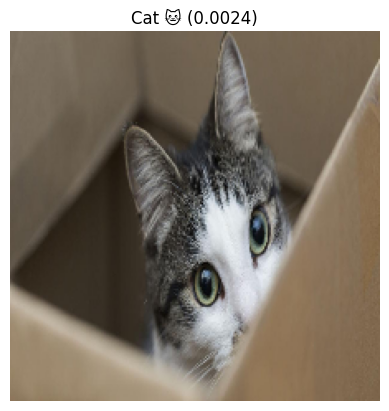

Image: cat_251.jpg
Prediction: Cat 🐱, Confidence: 0.0024

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


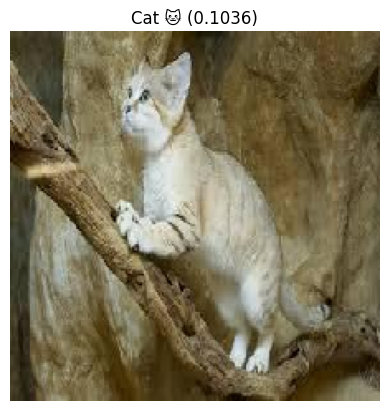

Image: cat_255.jpg
Prediction: Cat 🐱, Confidence: 0.1036

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step


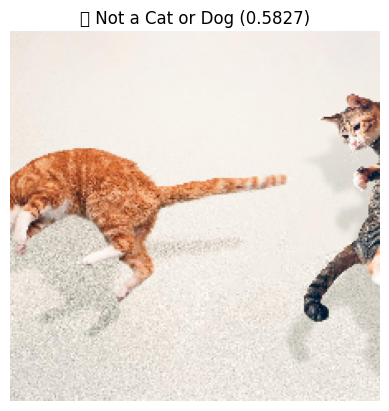

Image: cat_268.jpg
Prediction: ❌ Not a Cat or Dog, Confidence: 0.5827

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


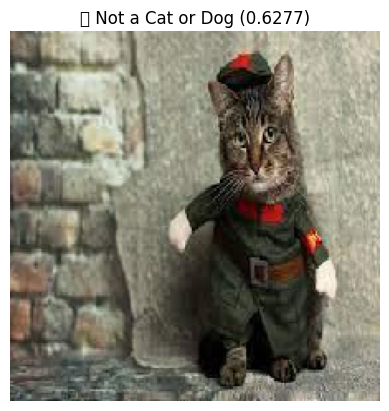

Image: cat_279.jpg
Prediction: ❌ Not a Cat or Dog, Confidence: 0.6277

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step


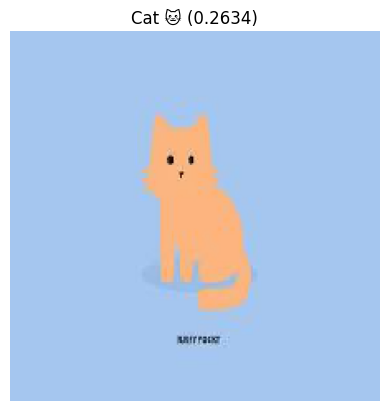

Image: cat_281.jpg
Prediction: Cat 🐱, Confidence: 0.2634

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


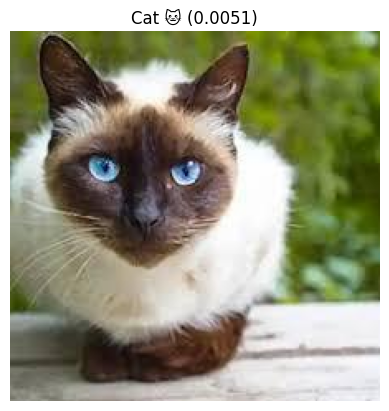

Image: cat_290.jpg
Prediction: Cat 🐱, Confidence: 0.0051

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


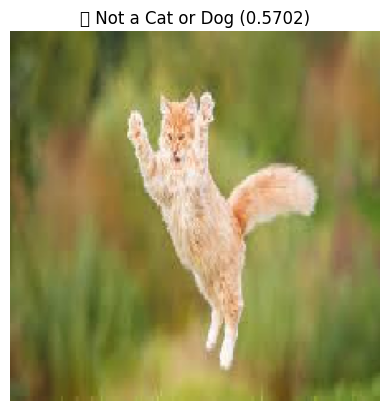

Image: cat_306.jpg
Prediction: ❌ Not a Cat or Dog, Confidence: 0.5702

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step


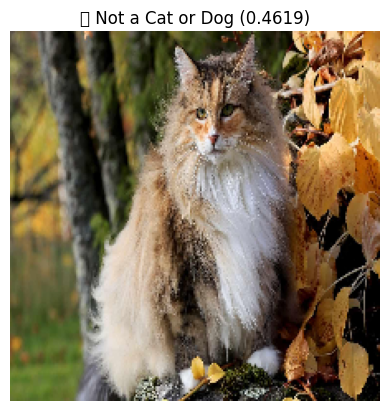

Image: cat_313.jpg
Prediction: ❌ Not a Cat or Dog, Confidence: 0.4619

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


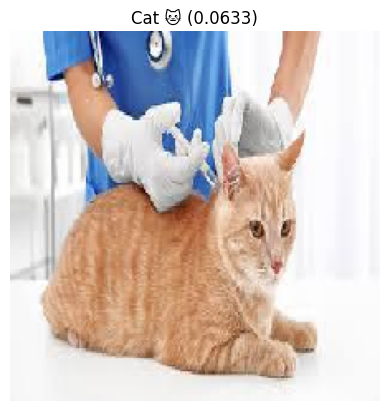

Image: cat_332.jpg
Prediction: Cat 🐱, Confidence: 0.0633

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


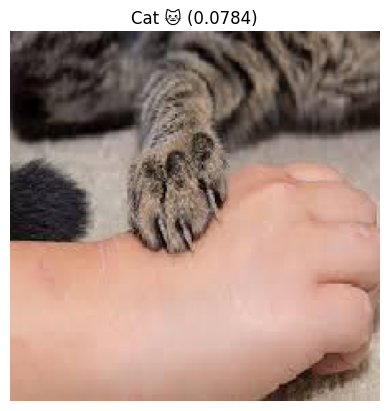

Image: cat_341.jpg
Prediction: Cat 🐱, Confidence: 0.0784

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


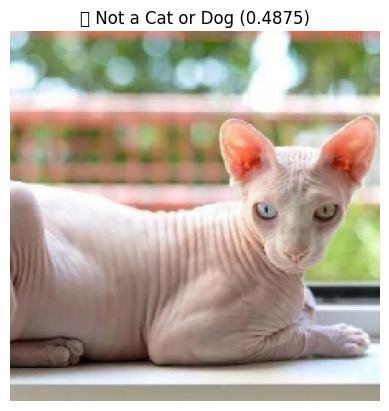

Image: cat_342.jpg
Prediction: ❌ Not a Cat or Dog, Confidence: 0.4875

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


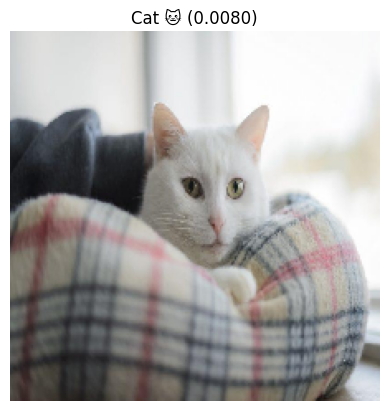

Image: cat_355.jpg
Prediction: Cat 🐱, Confidence: 0.0080

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step


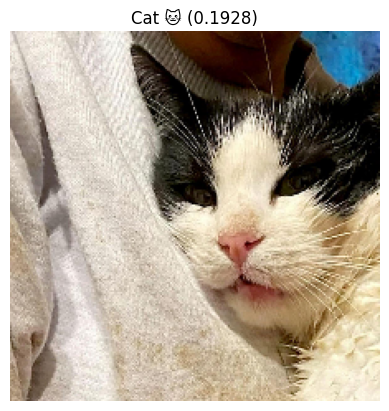

Image: cat_358.jpg
Prediction: Cat 🐱, Confidence: 0.1928

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


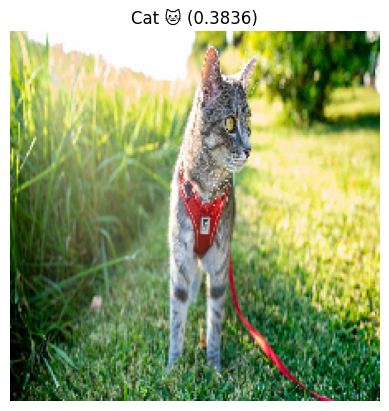

Image: cat_371.jpg
Prediction: Cat 🐱, Confidence: 0.3836

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step


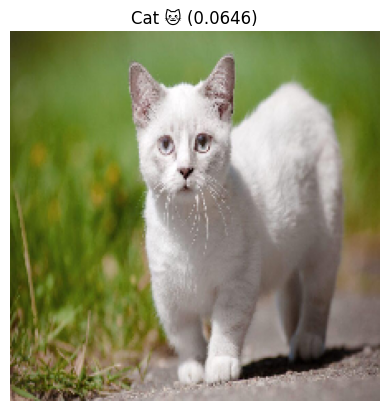

Image: cat_375.jpg
Prediction: Cat 🐱, Confidence: 0.0646

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


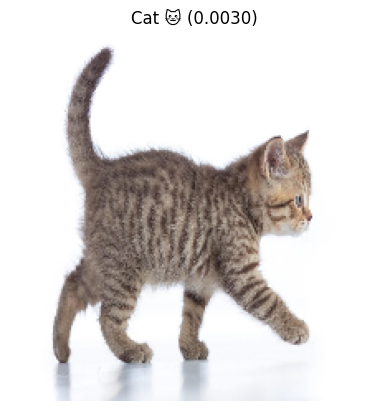

Image: cat_384.jpg
Prediction: Cat 🐱, Confidence: 0.0030

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


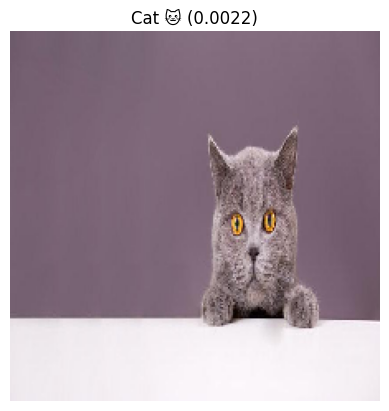

Image: cat_395.jpg
Prediction: Cat 🐱, Confidence: 0.0022

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


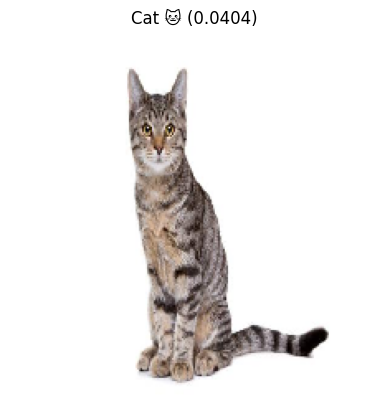

Image: cat_417.jpg
Prediction: Cat 🐱, Confidence: 0.0404

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


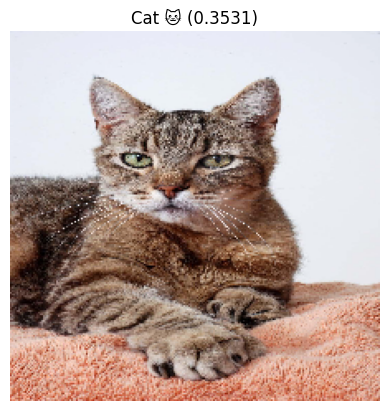

Image: cat_418.jpg
Prediction: Cat 🐱, Confidence: 0.3531

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step


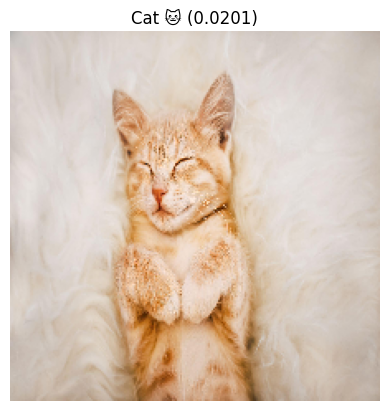

Image: cat_422.jpg
Prediction: Cat 🐱, Confidence: 0.0201

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


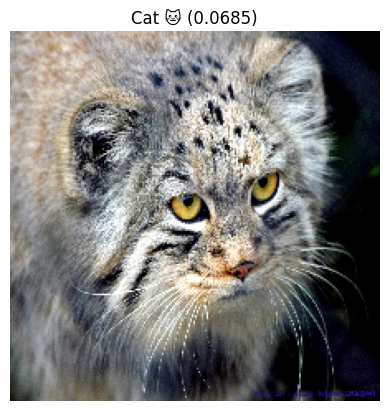

Image: cat_430.jpg
Prediction: Cat 🐱, Confidence: 0.0685

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step


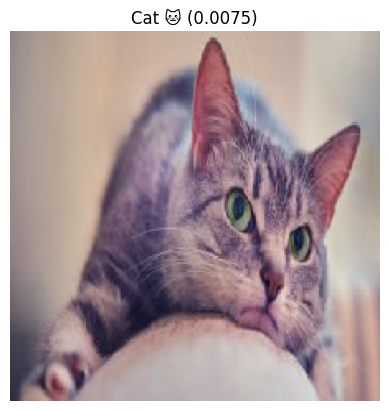

Image: cat_433.jpg
Prediction: Cat 🐱, Confidence: 0.0075

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


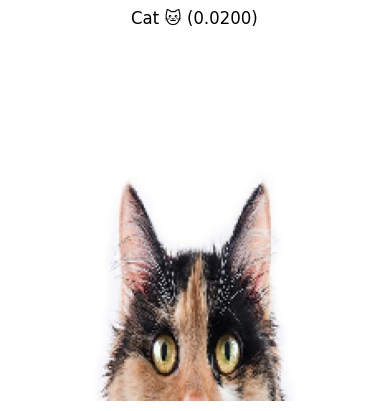

Image: cat_446.jpg
Prediction: Cat 🐱, Confidence: 0.0200

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step


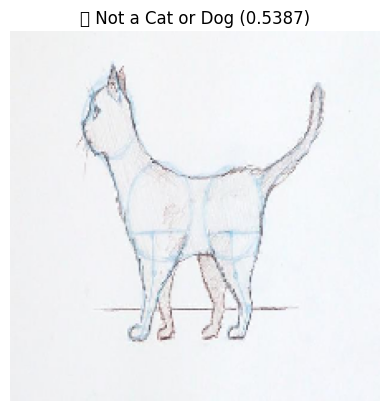

Image: cat_464.jpg
Prediction: ❌ Not a Cat or Dog, Confidence: 0.5387

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


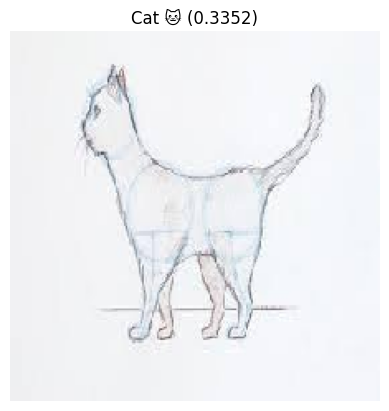

Image: cat_468.jpg
Prediction: Cat 🐱, Confidence: 0.3352

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


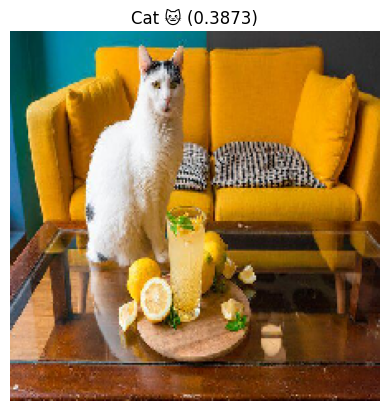

Image: cat_473.jpg
Prediction: Cat 🐱, Confidence: 0.3873

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


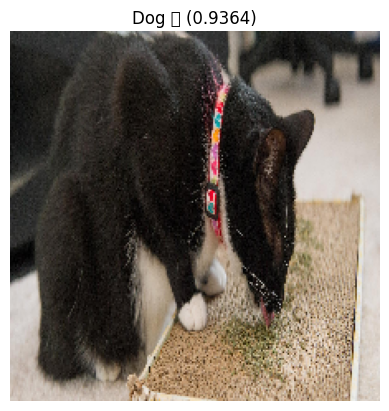

Image: cat_496.jpg
Prediction: Dog 🐶, Confidence: 0.9364

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step


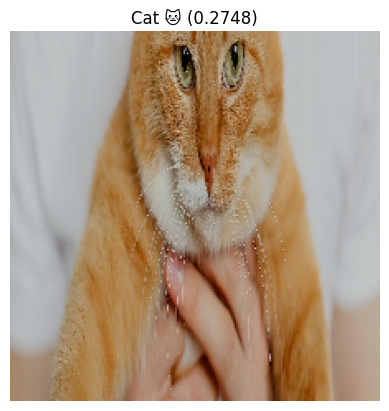

Image: cat_5.jpg
Prediction: Cat 🐱, Confidence: 0.2748

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step


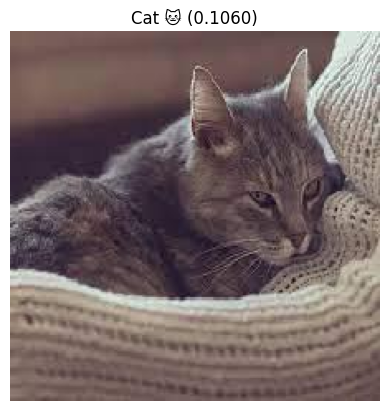

Image: cat_504.jpg
Prediction: Cat 🐱, Confidence: 0.1060

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


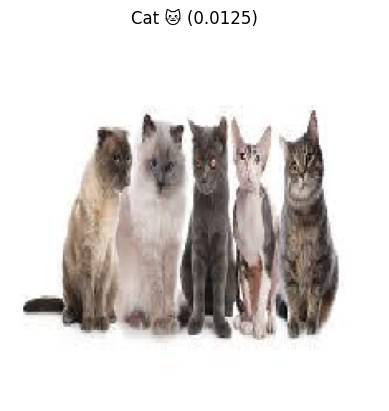

Image: cat_520.jpg
Prediction: Cat 🐱, Confidence: 0.0125

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


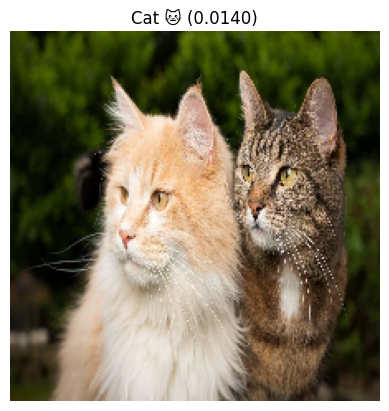

Image: cat_523.jpg
Prediction: Cat 🐱, Confidence: 0.0140

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step


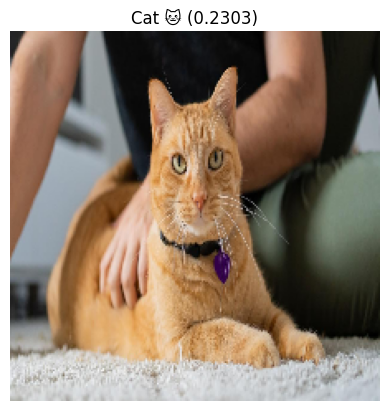

Image: cat_525.jpg
Prediction: Cat 🐱, Confidence: 0.2303

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


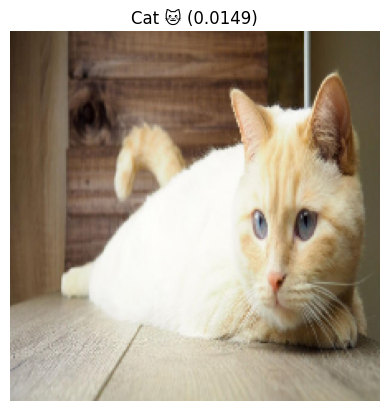

Image: cat_528.jpg
Prediction: Cat 🐱, Confidence: 0.0149

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


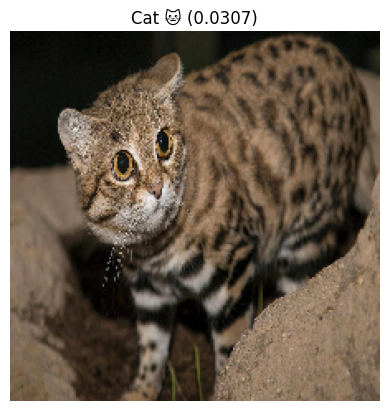

Image: cat_538.jpg
Prediction: Cat 🐱, Confidence: 0.0307

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


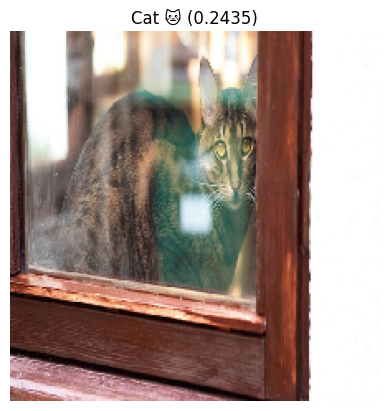

Image: cat_542.jpg
Prediction: Cat 🐱, Confidence: 0.2435

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


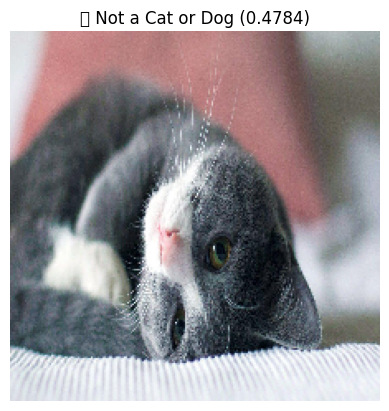

Image: cat_545.jpg
Prediction: ❌ Not a Cat or Dog, Confidence: 0.4784

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


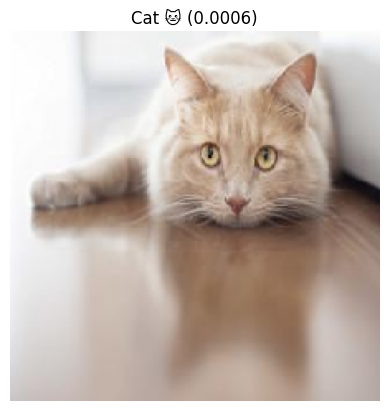

Image: cat_551.jpg
Prediction: Cat 🐱, Confidence: 0.0006

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


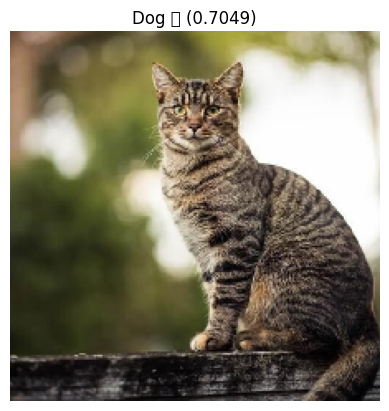

Image: cat_56.jpg
Prediction: Dog 🐶, Confidence: 0.7049

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


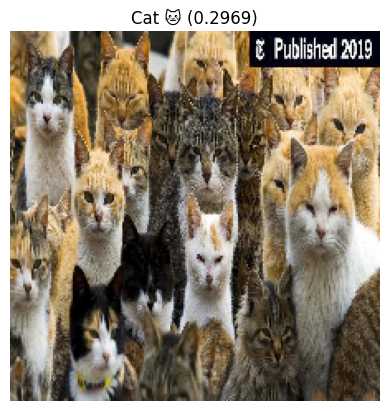

Image: cat_564.jpg
Prediction: Cat 🐱, Confidence: 0.2969

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


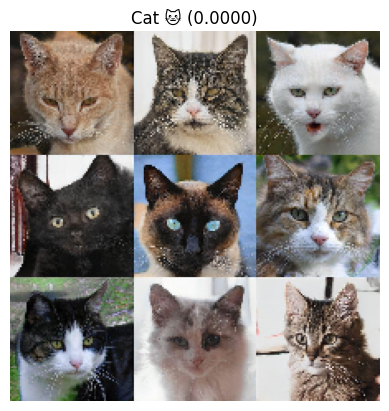

Image: cat_574.jpg
Prediction: Cat 🐱, Confidence: 0.0000

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


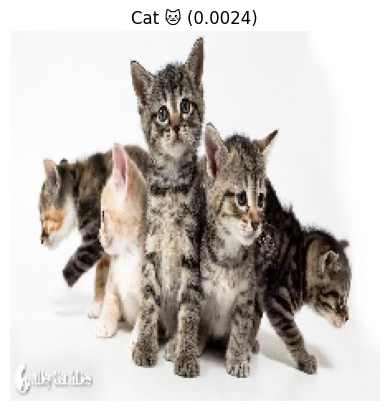

Image: cat_575.jpg
Prediction: Cat 🐱, Confidence: 0.0024

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


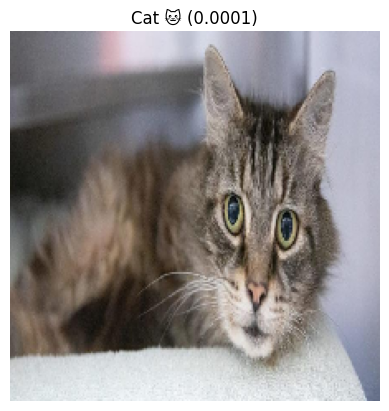

Image: cat_583.jpg
Prediction: Cat 🐱, Confidence: 0.0001

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


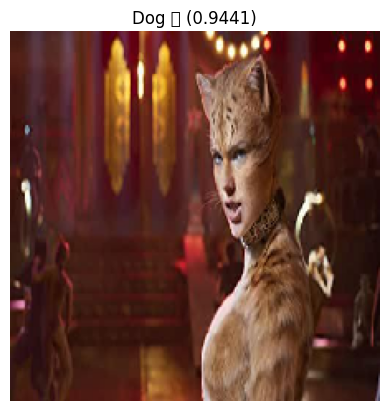

Image: cat_585.jpg
Prediction: Dog 🐶, Confidence: 0.9441

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


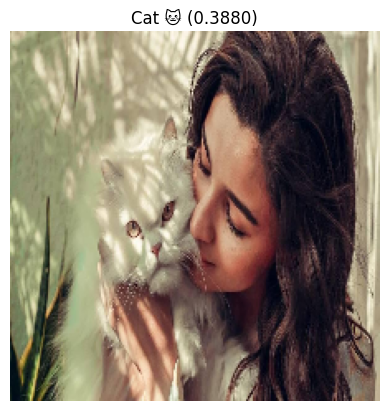

Image: cat_586.jpg
Prediction: Cat 🐱, Confidence: 0.3880

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


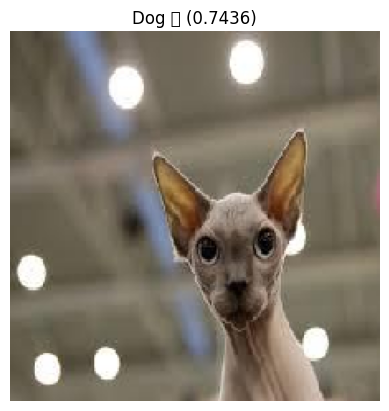

Image: cat_587.jpg
Prediction: Dog 🐶, Confidence: 0.7436

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


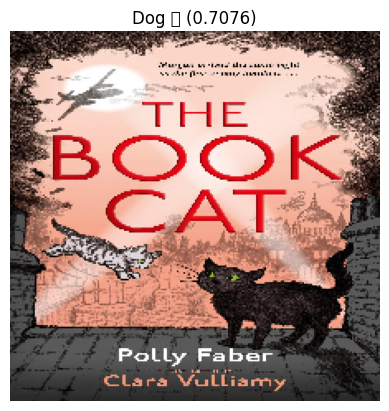

Image: cat_595.jpg
Prediction: Dog 🐶, Confidence: 0.7076

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


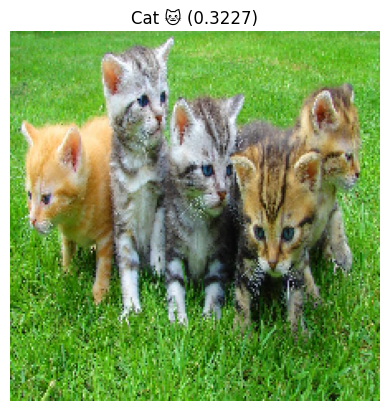

Image: cat_60.jpg
Prediction: Cat 🐱, Confidence: 0.3227

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


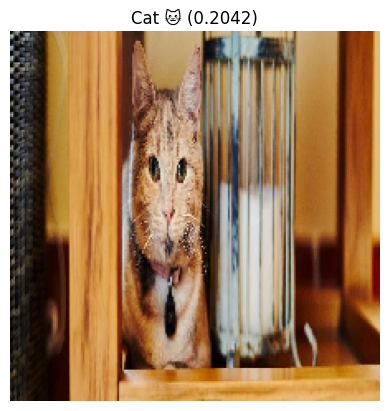

Image: cat_88.jpg
Prediction: Cat 🐱, Confidence: 0.2042

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


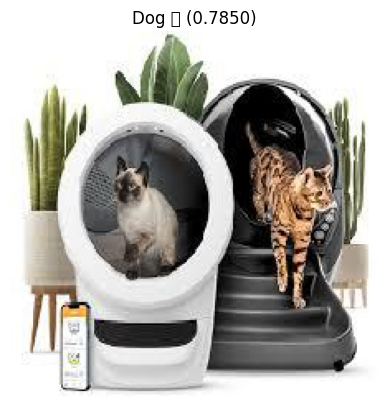

Image: cat_94.jpg
Prediction: Dog 🐶, Confidence: 0.7850

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


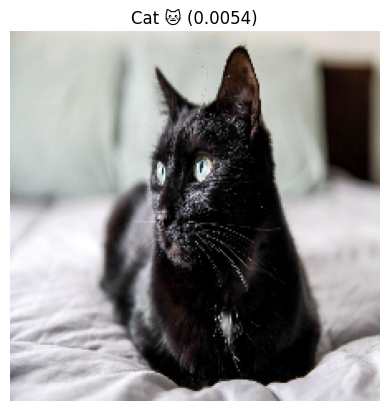

Image: cat_96.jpg
Prediction: Cat 🐱, Confidence: 0.0054

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


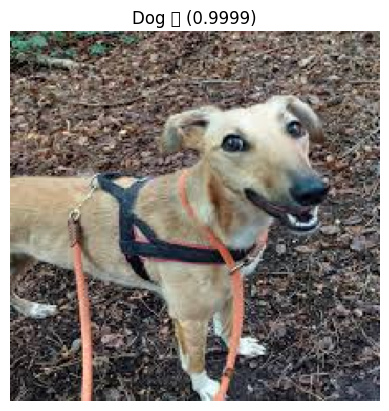

Image: dog_114.jpg
Prediction: Dog 🐶, Confidence: 0.9999

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


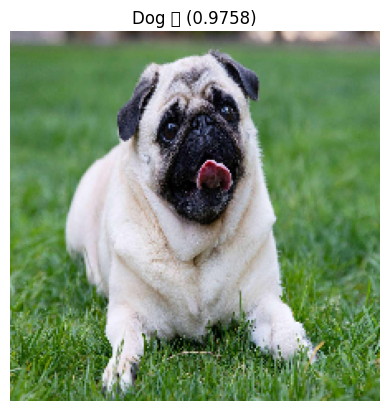

Image: dog_123.jpg
Prediction: Dog 🐶, Confidence: 0.9758

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


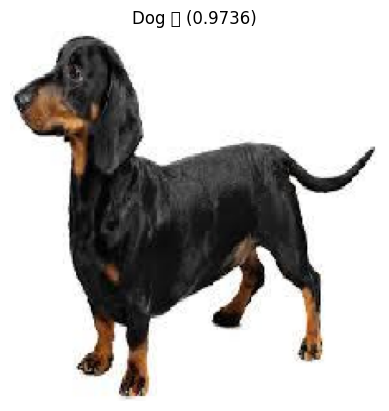

Image: dog_124.jpg
Prediction: Dog 🐶, Confidence: 0.9736

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


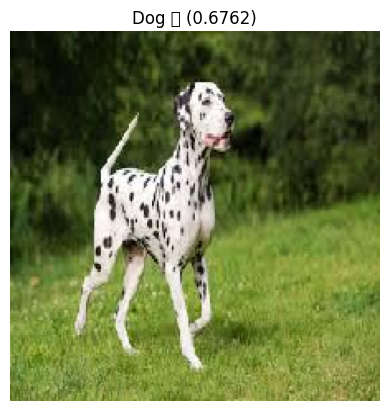

Image: dog_130.jpg
Prediction: Dog 🐶, Confidence: 0.6762

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


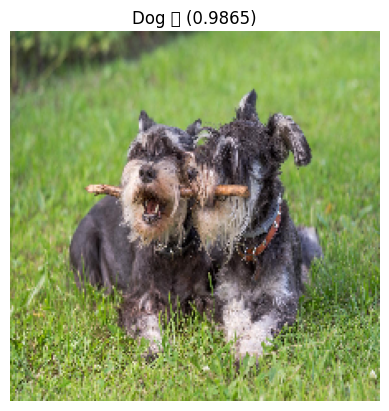

Image: dog_141.jpg
Prediction: Dog 🐶, Confidence: 0.9865

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step


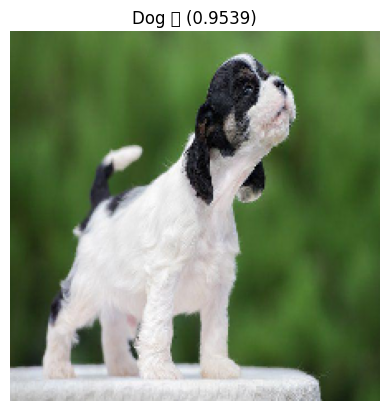

Image: dog_142.jpg
Prediction: Dog 🐶, Confidence: 0.9539

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step


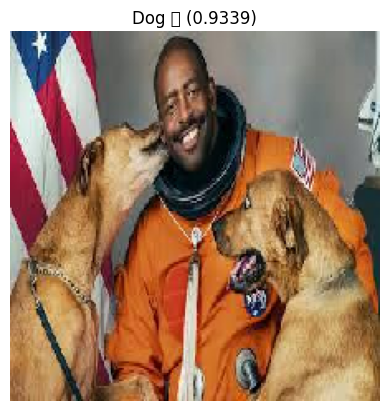

Image: dog_147.jpg
Prediction: Dog 🐶, Confidence: 0.9339

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


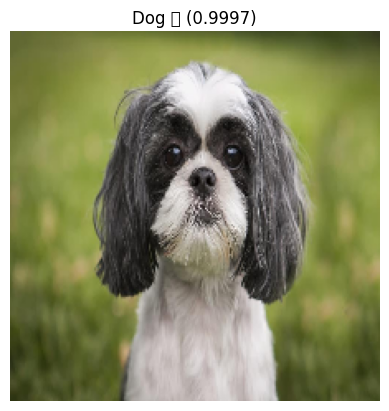

Image: dog_150.jpg
Prediction: Dog 🐶, Confidence: 0.9997

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


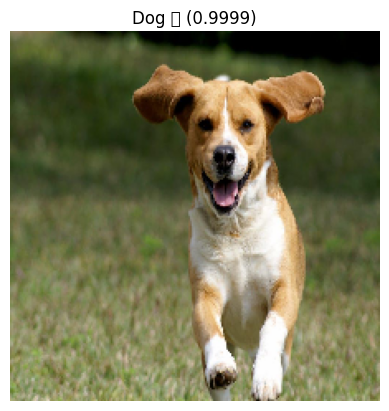

Image: dog_155.jpg
Prediction: Dog 🐶, Confidence: 0.9999

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


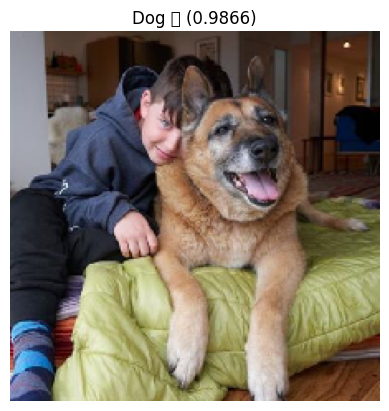

Image: dog_159.jpg
Prediction: Dog 🐶, Confidence: 0.9866

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


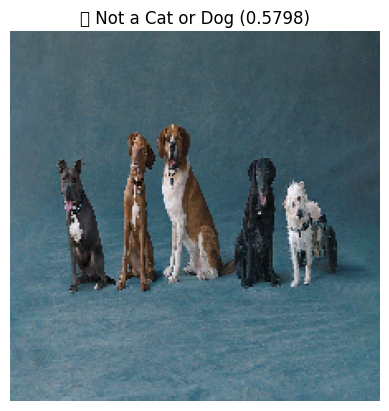

Image: dog_168.jpg
Prediction: ❌ Not a Cat or Dog, Confidence: 0.5798

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


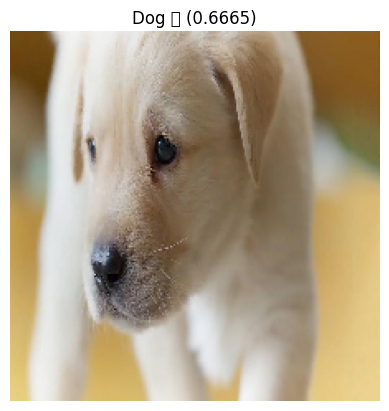

Image: dog_173.jpg
Prediction: Dog 🐶, Confidence: 0.6665

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


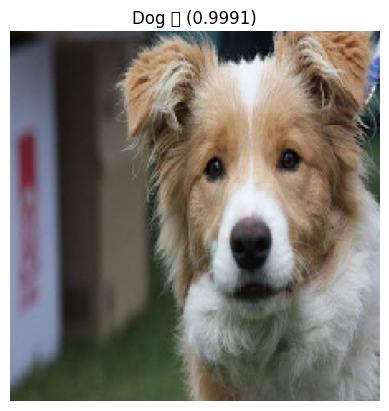

Image: dog_177.jpg
Prediction: Dog 🐶, Confidence: 0.9991

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step


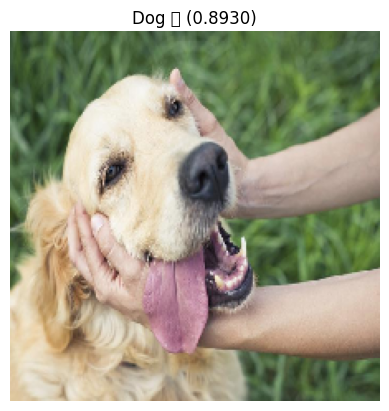

Image: dog_181.jpg
Prediction: Dog 🐶, Confidence: 0.8930

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


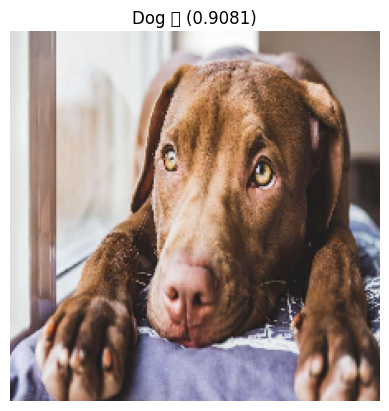

Image: dog_191.jpg
Prediction: Dog 🐶, Confidence: 0.9081

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


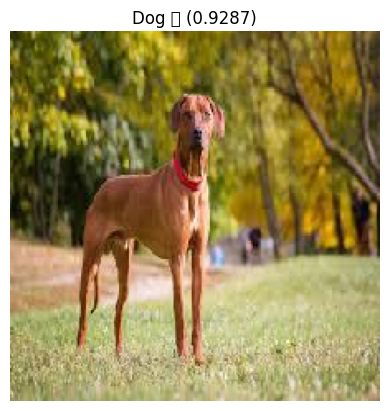

Image: dog_194.jpg
Prediction: Dog 🐶, Confidence: 0.9287

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


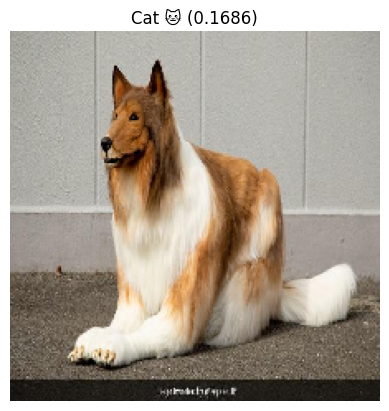

Image: dog_196.jpg
Prediction: Cat 🐱, Confidence: 0.1686

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


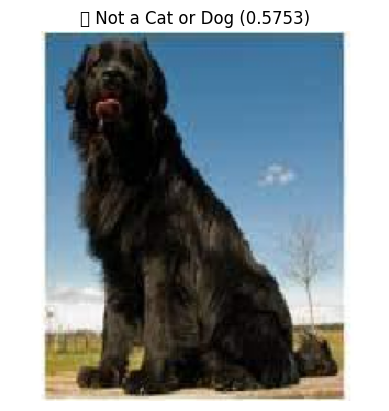

Image: dog_197.jpg
Prediction: ❌ Not a Cat or Dog, Confidence: 0.5753

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


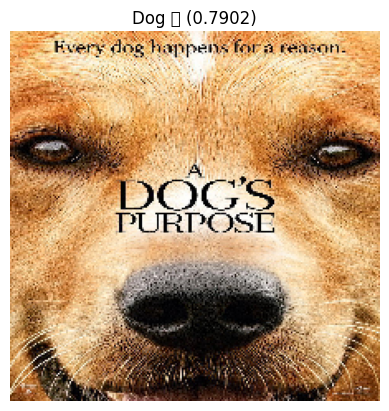

Image: dog_211.jpg
Prediction: Dog 🐶, Confidence: 0.7902

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


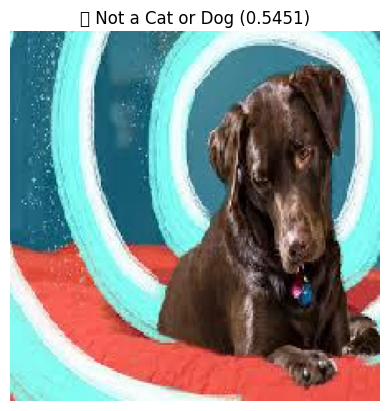

Image: dog_213.jpg
Prediction: ❌ Not a Cat or Dog, Confidence: 0.5451

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


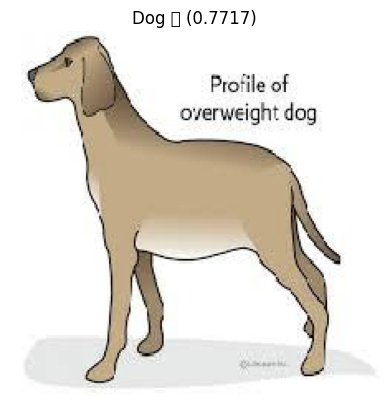

Image: dog_219.jpg
Prediction: Dog 🐶, Confidence: 0.7717

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


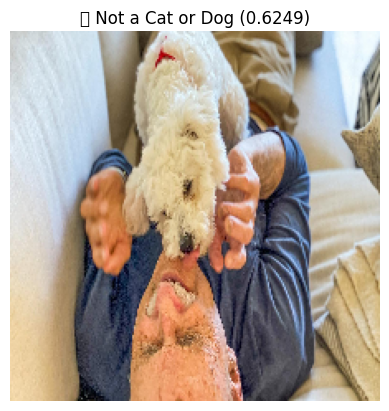

Image: dog_227.jpg
Prediction: ❌ Not a Cat or Dog, Confidence: 0.6249

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


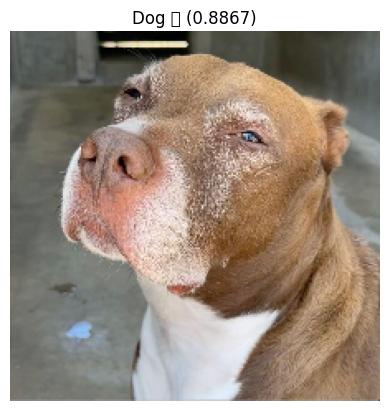

Image: dog_229.jpg
Prediction: Dog 🐶, Confidence: 0.8867

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


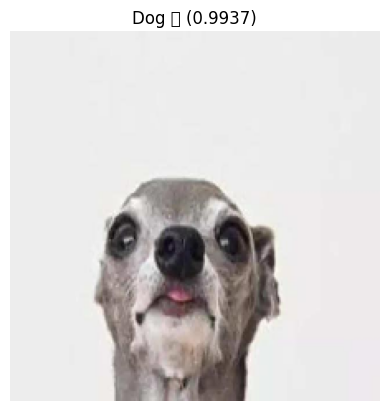

Image: dog_236.jpg
Prediction: Dog 🐶, Confidence: 0.9937

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


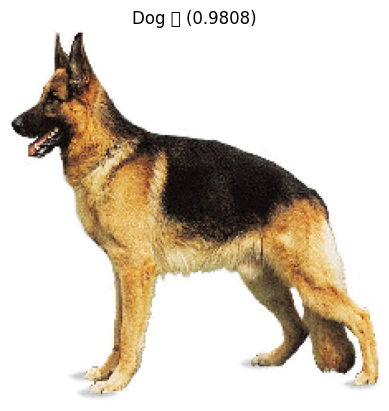

Image: dog_237.jpg
Prediction: Dog 🐶, Confidence: 0.9808

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


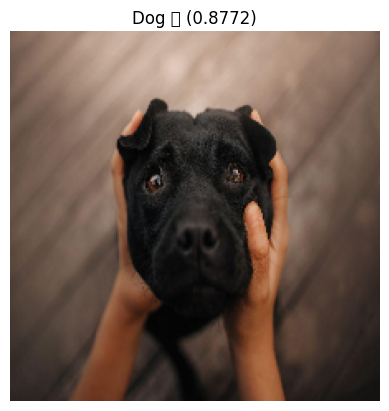

Image: dog_240.jpg
Prediction: Dog 🐶, Confidence: 0.8772

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


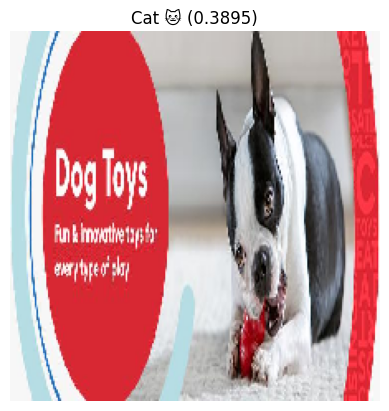

Image: dog_244.jpg
Prediction: Cat 🐱, Confidence: 0.3895

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


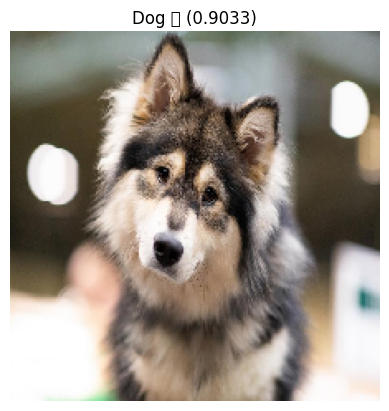

Image: dog_258.jpg
Prediction: Dog 🐶, Confidence: 0.9033

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


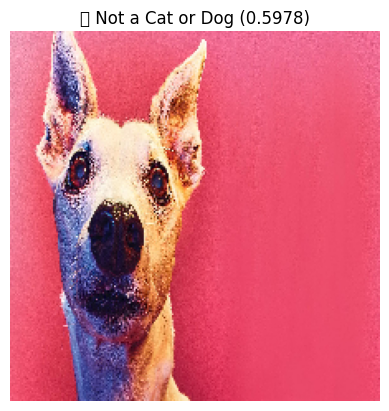

Image: dog_28.jpg
Prediction: ❌ Not a Cat or Dog, Confidence: 0.5978

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


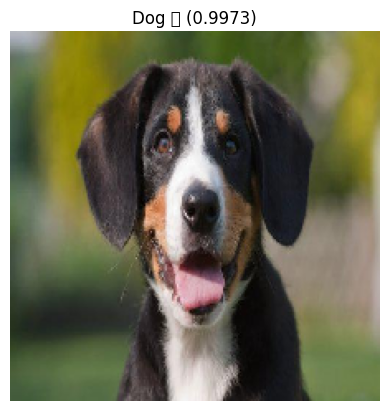

Image: dog_283.jpg
Prediction: Dog 🐶, Confidence: 0.9973

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


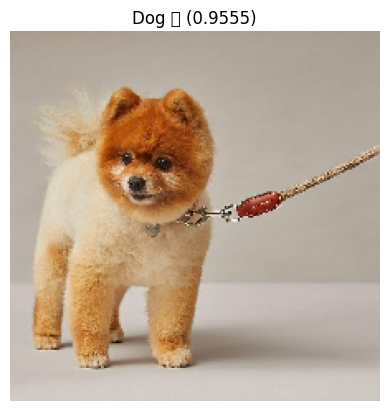

Image: dog_302.jpg
Prediction: Dog 🐶, Confidence: 0.9555

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


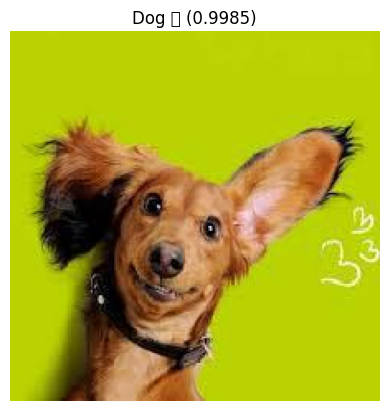

Image: dog_303.jpg
Prediction: Dog 🐶, Confidence: 0.9985

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step


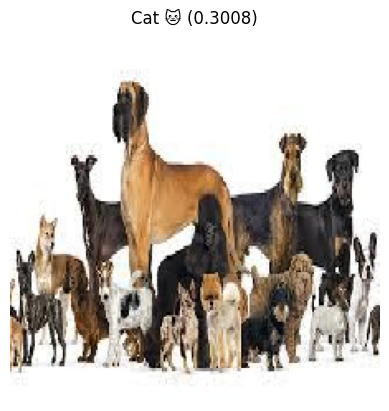

Image: dog_313.jpg
Prediction: Cat 🐱, Confidence: 0.3008

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


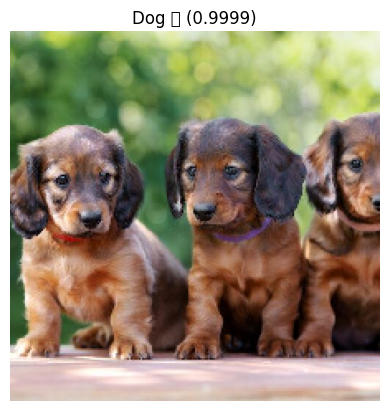

Image: dog_327.jpg
Prediction: Dog 🐶, Confidence: 0.9999

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


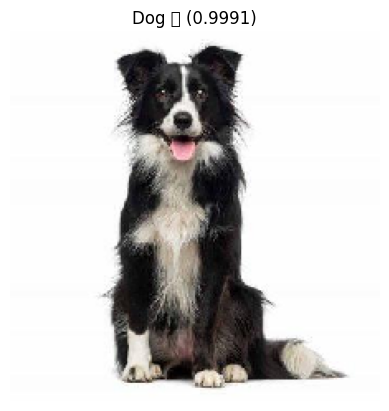

Image: dog_344.jpg
Prediction: Dog 🐶, Confidence: 0.9991

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


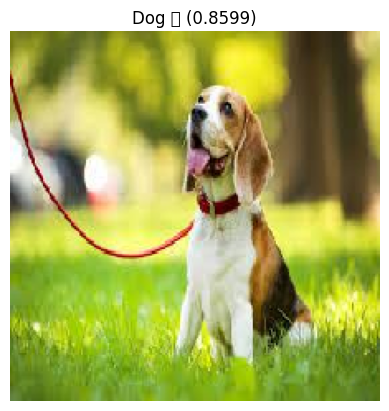

Image: dog_354.jpg
Prediction: Dog 🐶, Confidence: 0.8599

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


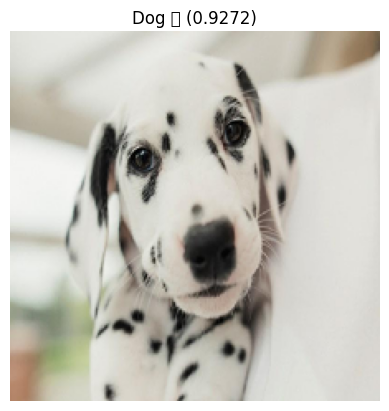

Image: dog_355.jpg
Prediction: Dog 🐶, Confidence: 0.9272

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


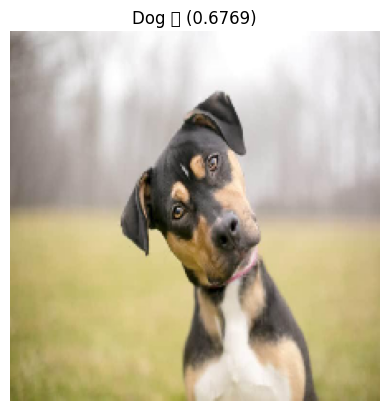

Image: dog_360.jpg
Prediction: Dog 🐶, Confidence: 0.6769

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


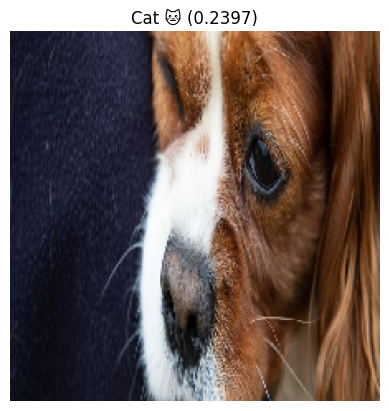

Image: dog_364.jpg
Prediction: Cat 🐱, Confidence: 0.2397

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


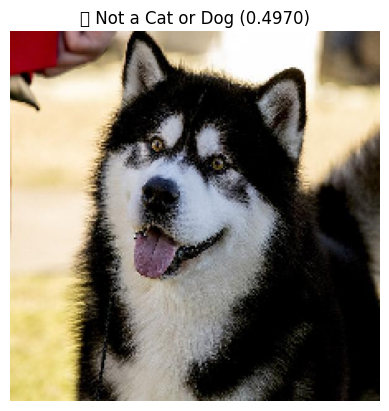

Image: dog_369.jpg
Prediction: ❌ Not a Cat or Dog, Confidence: 0.4970

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step


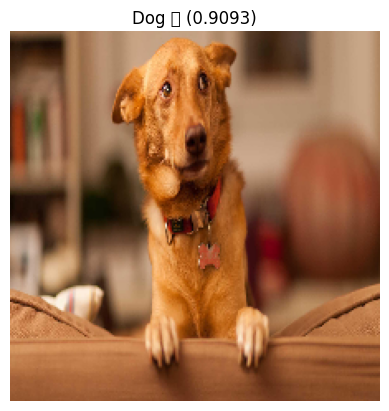

Image: dog_377.jpg
Prediction: Dog 🐶, Confidence: 0.9093

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


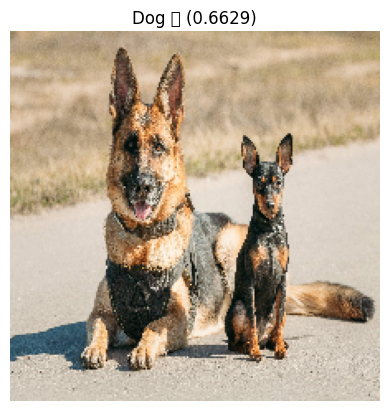

Image: dog_380.jpg
Prediction: Dog 🐶, Confidence: 0.6629

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


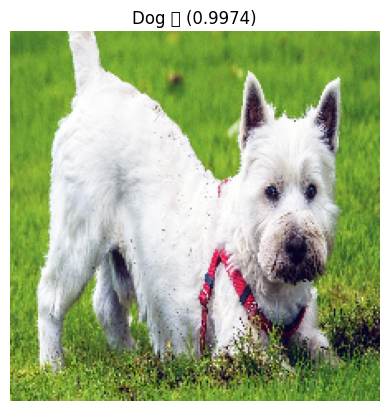

Image: dog_398.jpg
Prediction: Dog 🐶, Confidence: 0.9974

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


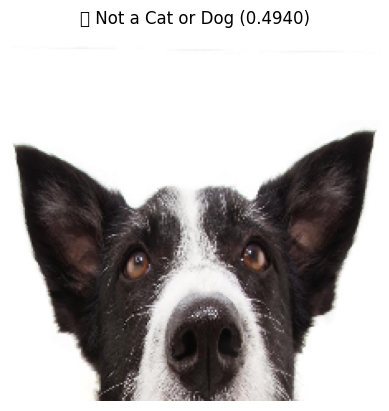

Image: dog_415.jpg
Prediction: ❌ Not a Cat or Dog, Confidence: 0.4940

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


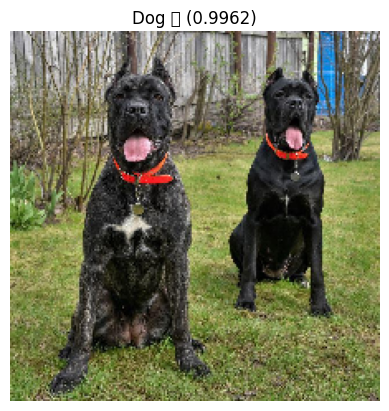

Image: dog_421.jpg
Prediction: Dog 🐶, Confidence: 0.9962

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step


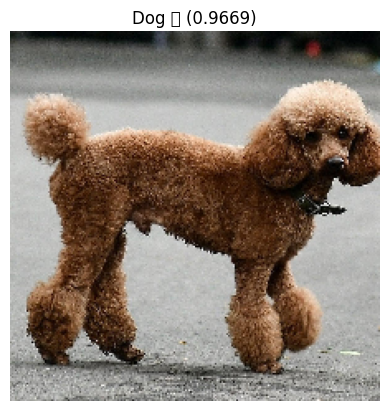

Image: dog_43.jpg
Prediction: Dog 🐶, Confidence: 0.9669

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


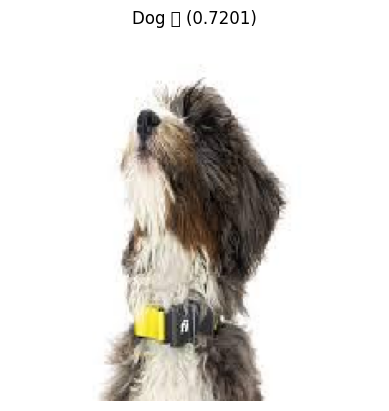

Image: dog_44.jpg
Prediction: Dog 🐶, Confidence: 0.7201

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


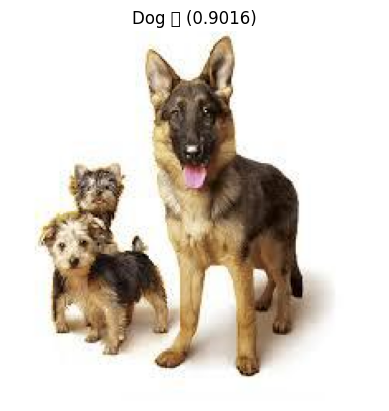

Image: dog_442.jpg
Prediction: Dog 🐶, Confidence: 0.9016

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


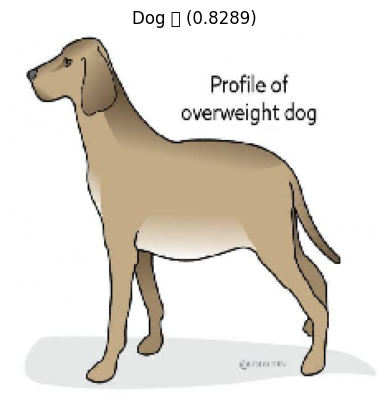

Image: dog_443.jpg
Prediction: Dog 🐶, Confidence: 0.8289

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


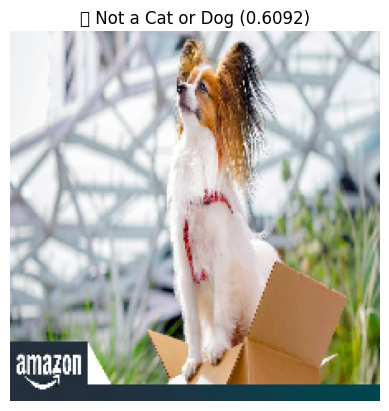

Image: dog_461.jpg
Prediction: ❌ Not a Cat or Dog, Confidence: 0.6092

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


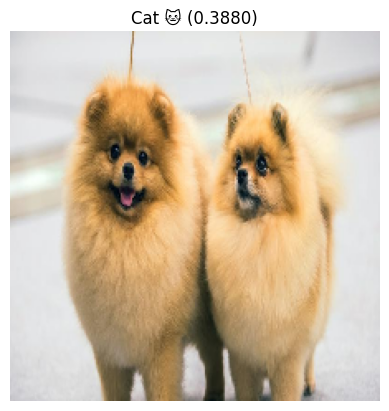

Image: dog_462.jpg
Prediction: Cat 🐱, Confidence: 0.3880

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


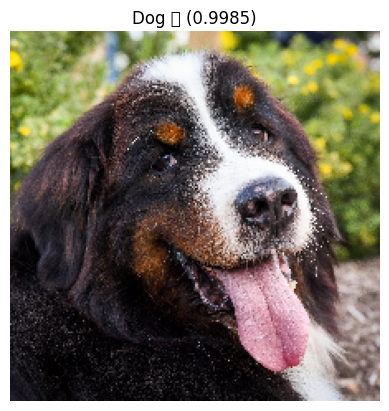

Image: dog_464.jpg
Prediction: Dog 🐶, Confidence: 0.9985

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


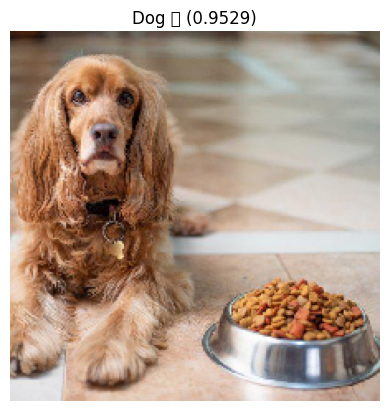

Image: dog_472.jpg
Prediction: Dog 🐶, Confidence: 0.9529

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


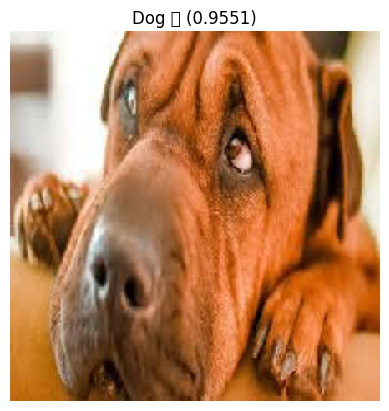

Image: dog_476.jpg
Prediction: Dog 🐶, Confidence: 0.9551

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


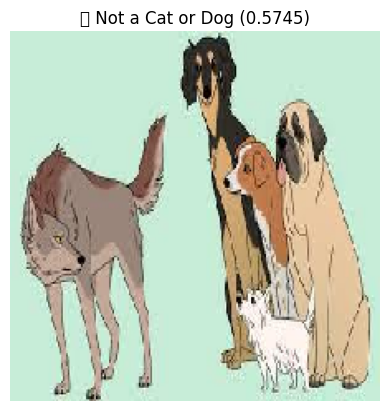

Image: dog_482.jpg
Prediction: ❌ Not a Cat or Dog, Confidence: 0.5745

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


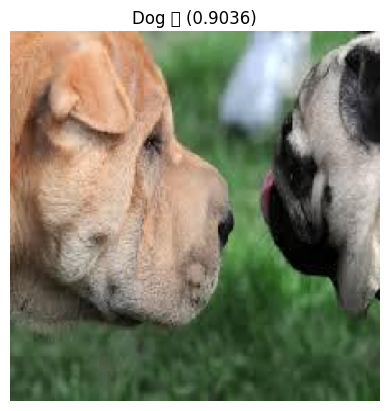

Image: dog_517.jpg
Prediction: Dog 🐶, Confidence: 0.9036

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


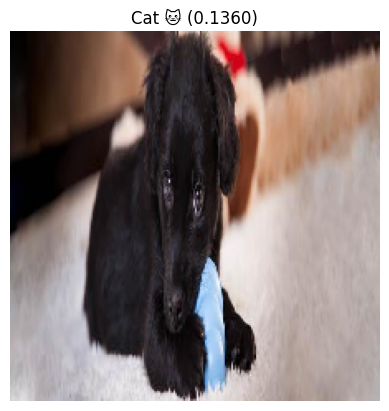

Image: dog_518.jpg
Prediction: Cat 🐱, Confidence: 0.1360

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


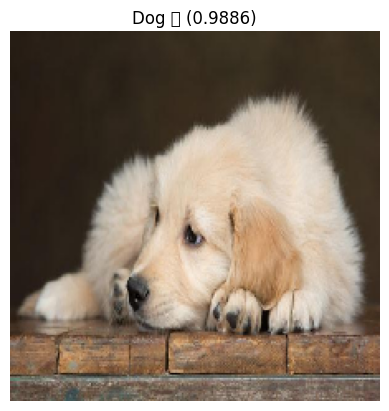

Image: dog_519.jpg
Prediction: Dog 🐶, Confidence: 0.9886

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


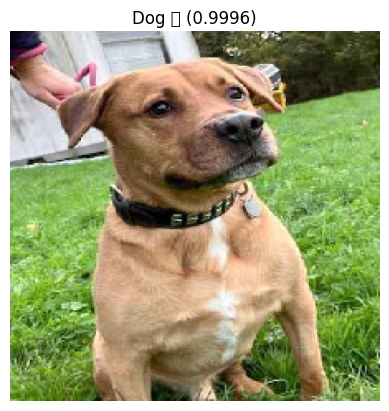

Image: dog_520.jpg
Prediction: Dog 🐶, Confidence: 0.9996

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


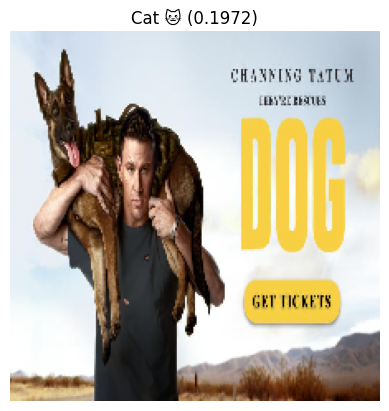

Image: dog_521.jpg
Prediction: Cat 🐱, Confidence: 0.1972

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


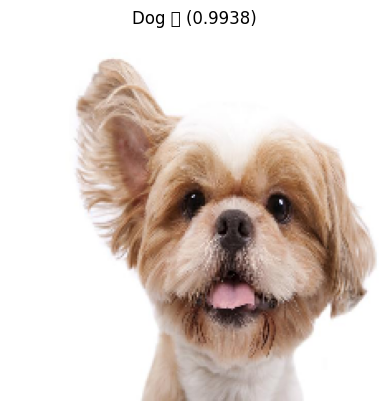

Image: dog_522.jpg
Prediction: Dog 🐶, Confidence: 0.9938

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step


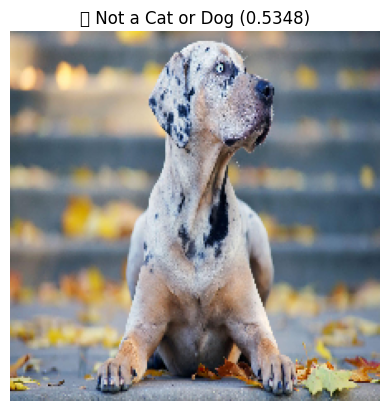

Image: dog_528.jpg
Prediction: ❌ Not a Cat or Dog, Confidence: 0.5348

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step


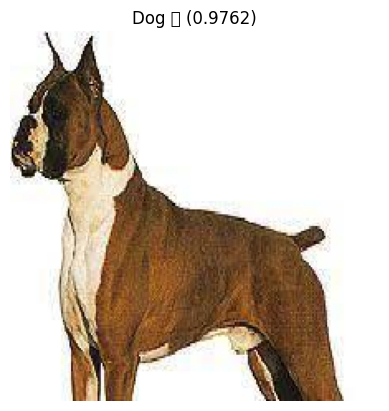

Image: dog_534.jpg
Prediction: Dog 🐶, Confidence: 0.9762

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


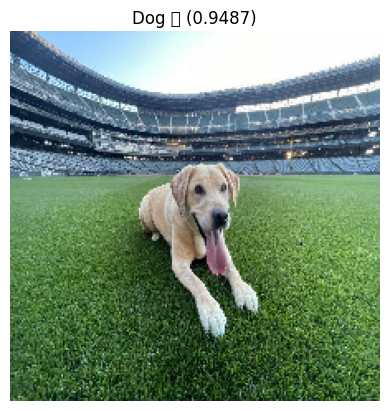

Image: dog_536.jpg
Prediction: Dog 🐶, Confidence: 0.9487

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


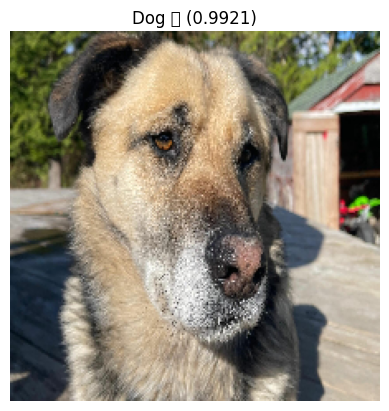

Image: dog_551.jpg
Prediction: Dog 🐶, Confidence: 0.9921

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


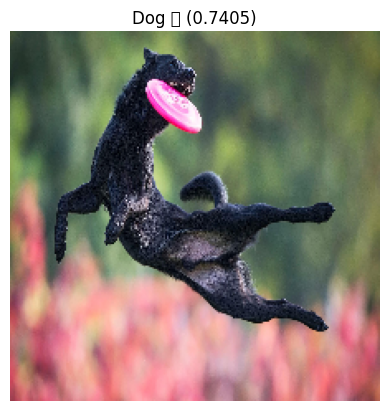

Image: dog_563.jpg
Prediction: Dog 🐶, Confidence: 0.7405

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


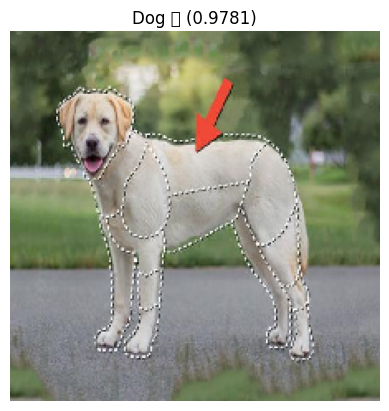

Image: dog_59.jpg
Prediction: Dog 🐶, Confidence: 0.9781

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


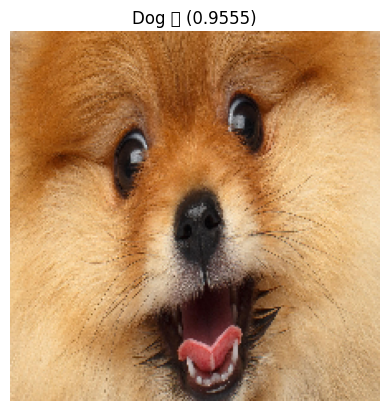

Image: dog_68.jpg
Prediction: Dog 🐶, Confidence: 0.9555

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


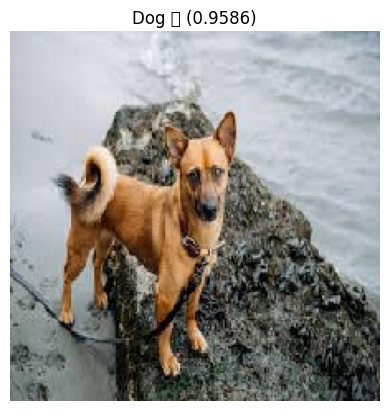

Image: dog_75.jpg
Prediction: Dog 🐶, Confidence: 0.9586

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


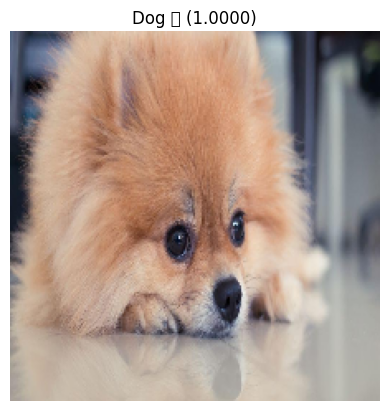

Image: dog_89.jpg
Prediction: Dog 🐶, Confidence: 1.0000



In [13]:
# Load model
model = load_model("../model/model.h5")

# Folder with only images
test_folder = "../test"

# Thresholds
cat_threshold = 0.4
dog_threshold = 0.65

print("\n🔍 Running predictions on TEST folder…")

for img_name in os.listdir(test_folder):

    img_path = os.path.join(test_folder, img_name)

    # Skip non-image files
    if not img_path.lower().endswith((".jpg", ".jpeg", ".png", ".bmp", ".webp")):
        continue

    # Load & preprocess image
    img = image.load_img(img_path, target_size=(224, 224))
    img_array = image.img_to_array(img) / 255.0
    img_array = np.expand_dims(img_array, axis=0)

    # Predict
    prob = model.predict(img_array)[0][0]

    # Classify
    if prob < cat_threshold:
        label = "Cat 🐱"
    elif prob > dog_threshold:
        label = "Dog 🐶"
    else:
        label = "❌ Not a Cat or Dog"

    # Show image
    plt.imshow(img)
    plt.axis('off')
    plt.title(f"{label} ({prob:.4f})")
    plt.show()

    print(f"Image: {img_name}")
    print(f"Prediction: {label}, Confidence: {prob:.4f}\n")

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step


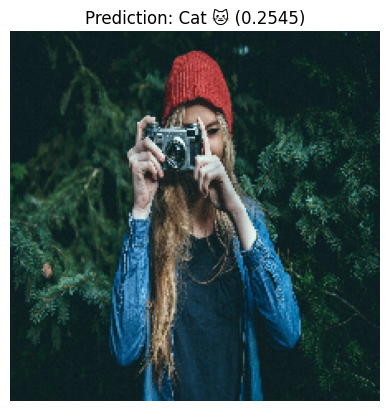

Predicted: Cat 🐱, Confidence: 0.2545


In [28]:
img_path = "./a.png"   # your image path

# 1️⃣ Load & preprocess
img = image.load_img(img_path, target_size=(224, 224))
img_array = image.img_to_array(img) / 255.0
img_array = np.expand_dims(img_array, axis=0)

# 2️⃣ Predict
prediction = model.predict(img_array)
prob = prediction[0][0]

# 3️⃣ Define thresholds
cat_threshold = 0.4
dog_threshold = 0.65

# 4️⃣ Classify
if prob < cat_threshold:
    label = "Cat 🐱"
elif prob > dog_threshold:
    label = "Dog 🐶"
else:
    label = "❌ Not a Cat or Dog"

# 5️⃣ Display
plt.imshow(img)
plt.axis('off')
plt.title(f"Prediction: {label} ({prob:.4f})")
plt.show()

print(f"Predicted: {label}, Confidence: {prob:.4f}")



--- Predicting images in folder: cat ---
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


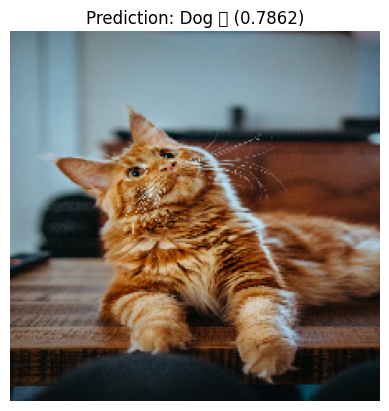

Predicted: Dog 🐶, Confidence: 0.7862
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step


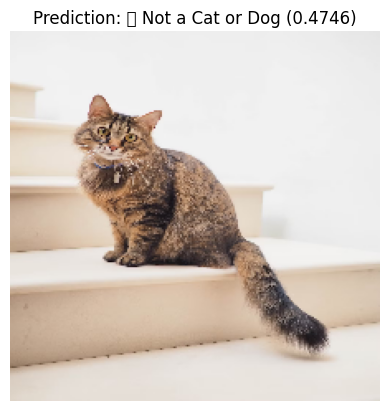

Predicted: ❌ Not a Cat or Dog, Confidence: 0.4746
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


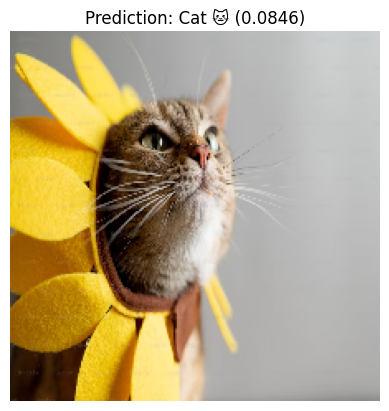

Predicted: Cat 🐱, Confidence: 0.0846
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


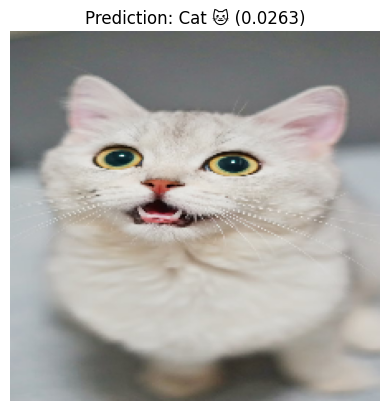

Predicted: Cat 🐱, Confidence: 0.0263
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


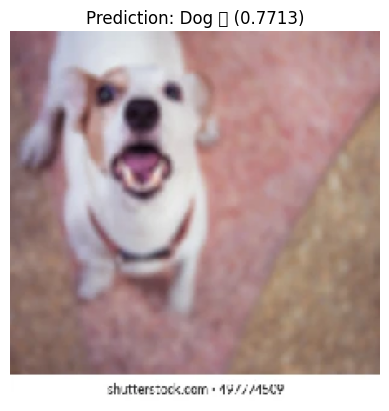

Predicted: Dog 🐶, Confidence: 0.7713
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


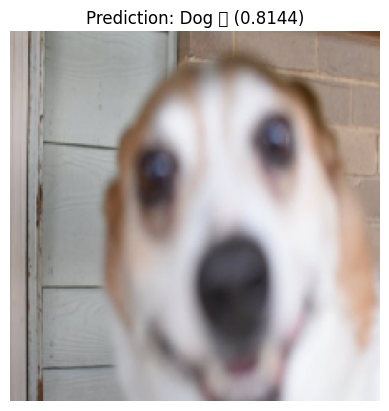

Predicted: Dog 🐶, Confidence: 0.8144
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step


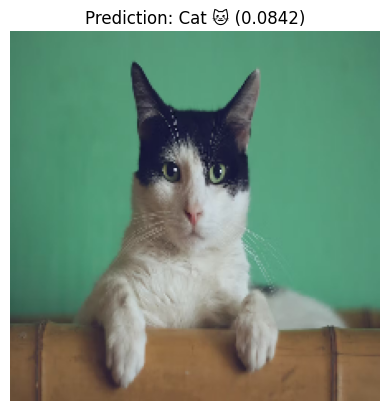

Predicted: Cat 🐱, Confidence: 0.0842
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step


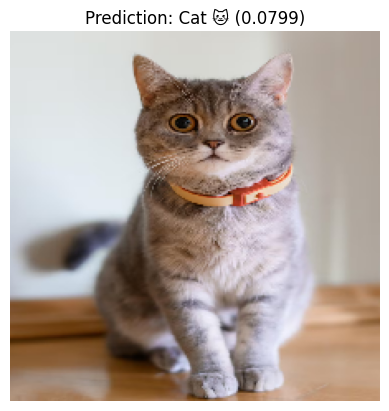

Predicted: Cat 🐱, Confidence: 0.0799
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step


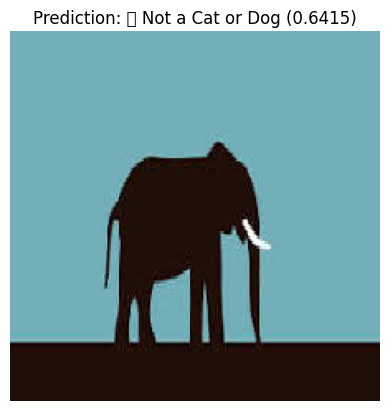

Predicted: ❌ Not a Cat or Dog, Confidence: 0.6415

--- Predicting images in folder: dog ---
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step


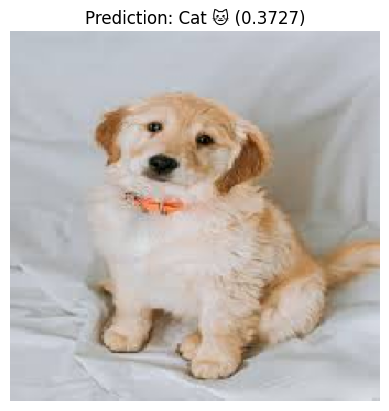

Predicted: Cat 🐱, Confidence: 0.3727
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


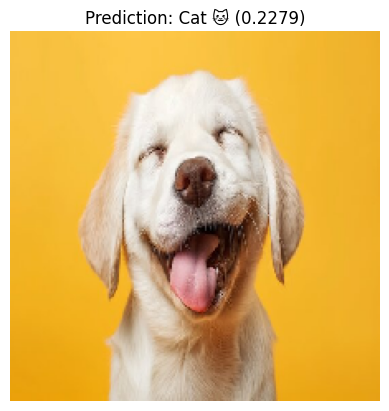

Predicted: Cat 🐱, Confidence: 0.2279
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step


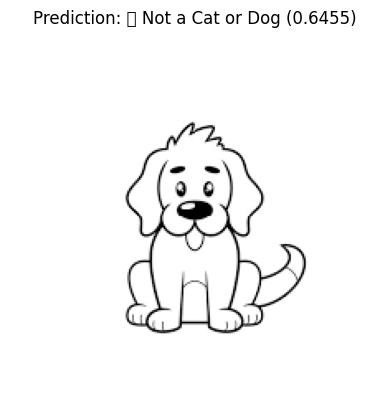

Predicted: ❌ Not a Cat or Dog, Confidence: 0.6455
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


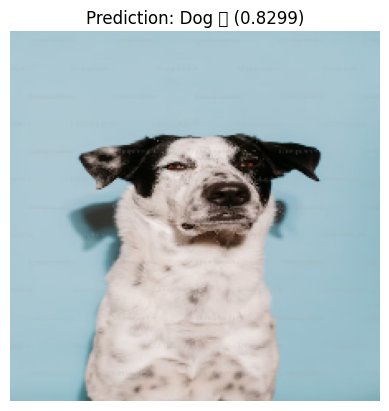

Predicted: Dog 🐶, Confidence: 0.8299
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step


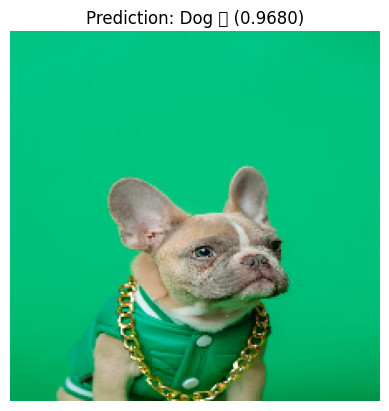

Predicted: Dog 🐶, Confidence: 0.9680
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step


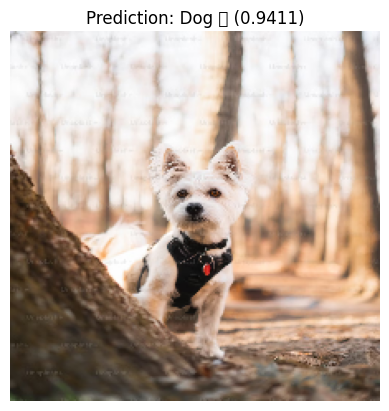

Predicted: Dog 🐶, Confidence: 0.9411
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


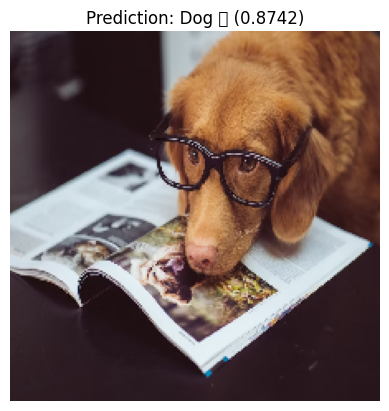

Predicted: Dog 🐶, Confidence: 0.8742
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


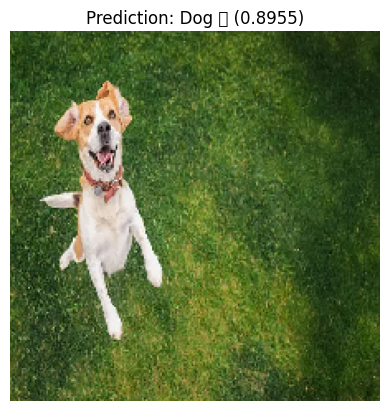

Predicted: Dog 🐶, Confidence: 0.8955
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


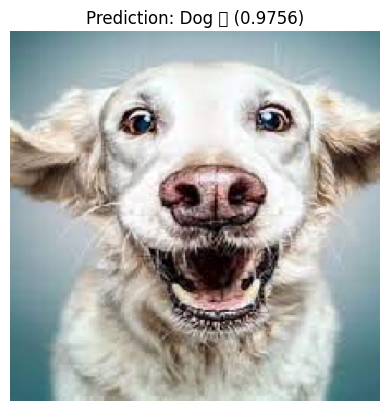

Predicted: Dog 🐶, Confidence: 0.9756
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


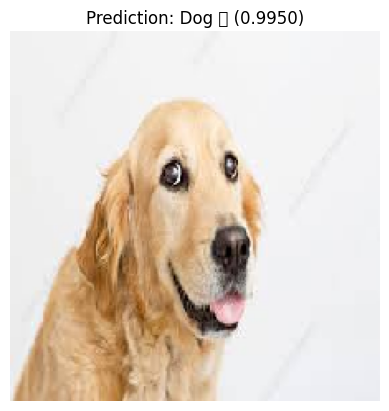

Predicted: Dog 🐶, Confidence: 0.9950


In [34]:

# Load your trained model
model = load_model("model.keras")  # or "model.h5" if using legacy

# Define image folder
base_dir = "testimg"

# Loop through subfolders (cat / dog)
for folder in os.listdir(base_dir):
    folder_path = os.path.join(base_dir, folder)

    if not os.path.isdir(folder_path):
        continue  # skip non-folder files

    print(f"\n--- Predicting images in folder: {folder} ---")

    for img_name in os.listdir(folder_path):
        img_path = os.path.join(folder_path, img_name)

        # Load and preprocess image
        img = image.load_img(img_path, target_size=(224, 224))  # adjust size to your model input
        img_array = image.img_to_array(img) / 255.0
        img_array = np.expand_dims(img_array, axis=0)

        # Predict
        prob = model.predict(img_array)[0][0]  # assuming output is a single sigmoid neuron

        # Define thresholds
        cat_threshold = 0.4
        dog_threshold = 0.65

        # Classify
        if prob < cat_threshold:
            label = "Cat 🐱"
        elif prob > dog_threshold:
            label = "Dog 🐶"
        else:
            label = "❌ Not a Cat or Dog"

        # Display
        plt.imshow(img)
        plt.axis('off')
        plt.title(f"Prediction: {label} ({prob:.4f})")
        plt.show()

        print(f"Predicted: {label}, Confidence: {prob:.4f}")
